# **Palm Recognition**

Tujuan utama dari notebook ini adalah untuk membangun dan melatih sebuah model deep learning yang mampu melakukan palmprint recognition.

- Dataset: Sapienza University Mobile Palmprint Database (SMPD)

- Tujuan: Dataset ini berisi ribuan gambar telapak tangan dari berbagai subjek, yang akan menjadi data utama untuk melatih dan menguji sistem recognition yang akan kita bangun.

In [1]:
import tensorflow as tf
import keras

# Check TensorFlow version
print('TensorFlow version:', tf.__version__)

# Check Keras version
print('Keras version:', keras.__version__)

TensorFlow version: 2.19.0
Keras version: 3.10.0


In [ ]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("mahdieizadpanah/sapienza-university-mobile-palmprint-databasesmpd")

print("Path to dataset files:", path)

In [3]:
path = kagglehub.dataset_download("mahdieizadpanah/birjand-university-mobile-palmprint-databasebmpd")

print("Path to dataset files:", path)

100%|██████████| 1.67G/1.67G [00:18<00:00, 96.1MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/mahdieizadpanah/birjand-university-mobile-palmprint-databasebmpd/versions/1


In [3]:
# 1. Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

# # 2. Create the destination folder in your Drive
# !mkdir -p /content/drive/MyDrive/datasets

# # 3. Move the downloaded datasets to your Drive for persistence
# # Note: You must run your download code first for these paths to exist
# !mv /kaggle/input/sapienza-university-mobile-palmprint-databasesmpd /content/drive/MyDrive/datasets/smpd
# !mv /root/.cache/kagglehub/datasets/mahdieizadpanah/birjand-university-mobile-palmprint-databasebmpd/versions/1 /content/drive/MyDrive/datasets/bmpd

# print("✅ Datasets successfully moved to Google Drive.")

Mounted at /content/drive


In [ ]:
 !apt-get update && apt-get install -y libgl1-mesa-glx

In [ ]:
!pip install numpy opencv-python==4.8.1.78 matplotlib==3.7.2

In [4]:
import cv2
import numpy as np
print(f"OpenCV: {cv2.__version__}")
print(f"NumPy: {np.__version__}")

OpenCV: 4.12.0
NumPy: 2.0.2


# **Percobaan menggunakan Valley-point approach**

Basically disini kita mencoba untuk mencari valley point (sela-sela jari), contohnya TF, 12, 23, 34. dengan 1 = Telunjuk, 2 = Jari Tengah, etc.

Tujuannya adalah untuk mencari lokasi palm relatif terhadap jari.

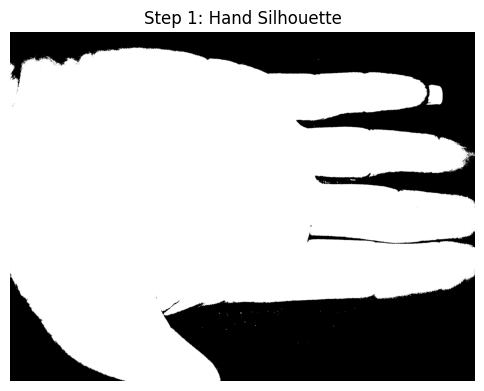

Step 1 complete. The silhouette image is ready.


In [7]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import math

# --- Block 1: Load and Binarize ---

# Define the image path
image_path = "/content/drive/MyDrive/datasets/smpd/Sapienza University Mobile Palmprint Database(SMPD)/001/001_F_0.JPG"

# Load the image in color (for drawing on later) and grayscale
original_img = cv2.imread(image_path)
grayscale_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2GRAY)

# Check if the image loaded correctly
if original_img is None:
    print(f"Error: Could not load image from {image_path}")
else:
    # Create the binary silhouette (white hand on black background)
    ret, silhouette_img = cv2.threshold(grayscale_img, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Display the result to confirm
    plt.figure(figsize=(6, 6))
    plt.imshow(silhouette_img, cmap='gray')
    plt.title('Step 1: Hand Silhouette')
    plt.axis('off')
    plt.show()

    print("Step 1 complete. The silhouette image is ready.")

Setelah mendapatkan silhouette, blok ini bertugas untuk mendeteksi contour (garis besar) dari bentuk tangan tersebut.

Kode ini secara spesifik mencari dan memilih contour dengan area terbesar. Tujuannya adalah untuk mengisolasi bentuk tangan secara akurat dan mengabaikan objek-objek kecil lain yang mungkin ada karena noise.

Hasil akhirnya adalah visualisasi contour tangan yang bersih, yang akan digunakan untuk analisis lebih lanjut.


Silhouette image type: <class 'numpy.ndarray'>
Silhouette image dtype: uint8
Silhouette image shape: (2448, 3264)
Canvas type: <class 'numpy.ndarray'>
Canvas dtype: uint8
Canvas shape: (2448, 3264)


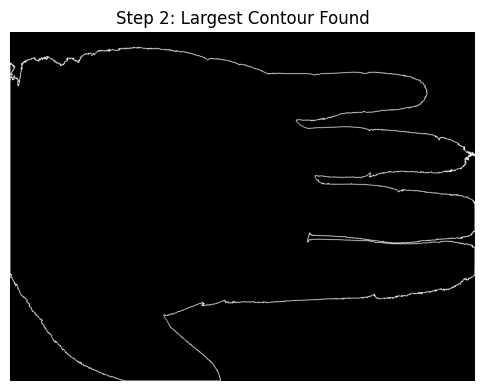

Step 2 complete. Found a hand contour with 14155 points.


In [8]:
# --- Block 2: Find the Largest Contour (Fixed Version) ---

import cv2
import matplotlib.pyplot as plt
import numpy as np

# Debug: Check the silhouette_img properties
print(f"Silhouette image type: {type(silhouette_img)}")
print(f"Silhouette image dtype: {silhouette_img.dtype}")
print(f"Silhouette image shape: {silhouette_img.shape}")

# Find all contours in the silhouette
contours, hierarchy = cv2.findContours(silhouette_img, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

if not contours:
    print("Error: No contours were found. Make sure the hand is white and the background is black.")
else:
    # Find the largest contour by area
    hand_contour = max(contours, key=cv2.contourArea)

    # Create a proper canvas - explicitly specify dtype and ensure it's a numpy array
    contour_canvas = np.zeros(silhouette_img.shape, dtype=np.uint8)

    # Debug: Check the canvas properties
    print(f"Canvas type: {type(contour_canvas)}")
    print(f"Canvas dtype: {contour_canvas.dtype}")
    print(f"Canvas shape: {contour_canvas.shape}")

    # Draw the contour - remove the .astype() call as it might be causing issues
    cv2.drawContours(contour_canvas, [hand_contour], -1, 255, 3)

    plt.figure(figsize=(6, 6))
    plt.imshow(contour_canvas, cmap='gray')
    plt.title('Step 2: Largest Contour Found')
    plt.axis('off')
    plt.show()

    print(f"Step 2 complete. Found a hand contour with {len(hand_contour)} points.")

Blok inti dari palm recognition, tujuannya adalah untuk menemukan key points, yaitu valleys (lembah) di antara jari-jari. Key points ini sangat penting karena akan digunakan sebagai patokan untuk mengekstrak Region of Interest (ROI).

Proses:

1.  Membuat convex hull di sekitar contour tangan. Area di mana contour asli melengkung ke dalam menjauhi hull ini disebut convexity defects. Valleys jari adalah defect yang paling dalam dan paling
2.  Filtering (Penyaringan): Tidak semua defect adalah valleys jari. Oleh karena itu, dilakukan penyaringan berdasarkan sudut dan posisi untuk memastikan hanya valleys yang relevan yang dipilih (bukan defects di area pergelangan tangan).
3.  Seleksi Akhir: Dari kandidat yang lolos filtering, kode ini memilih empat valleys terdalam. Keempat titik inilah yang dianggap sebagai key points akhir.

Hasil akhirnya adalah visualisasi gambar asli dengan empat key points yang terdeteksi.

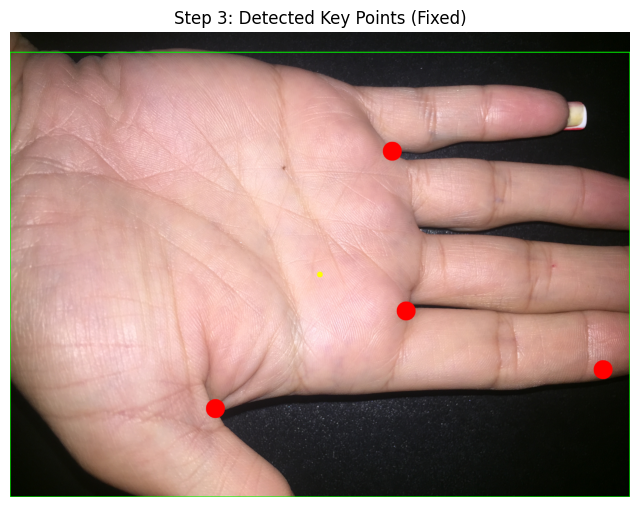

Step 3 complete. Selected the 4 deepest valley points.


In [30]:
# --- Block 3: Find Key Points (Fixed) ---

# This code assumes 'hand_contour' and 'original_img' exist from the previous steps.

M = cv2.moments(hand_contour)
if M["m00"] == 0:
    print("Error: Could not calculate the centroid of the contour.")
else:
    rect = cv2.minAreaRect(hand_contour)
    box = cv2.boxPoints(rect)
    box = np.intp(box)
    (cx, cy), (width, height), angle = rect

    # --- KEY CHANGE HERE ---
    # We use height for tolerance because it's more stable than width when fingers are spread.
    # The original value (0.15) was too small and cut off the lower thumb valley.
    # Increasing it to 0.4 allows the filter to include points further down the hand.
    positional_tolerance = height * 0.4

    hull_indices = cv2.convexHull(hand_contour, returnPoints=False)
    defects = cv2.convexityDefects(hand_contour, hull_indices)

    if defects is not None:
        potential_valleys = []
        # Create rotation matrix to align the hand vertically for consistent filtering
        rot_matrix = cv2.getRotationMatrix2D((cx, cy), angle, 1.0)

        for i in range(defects.shape[0]):
            s, e, f, d = defects[i, 0]
            far = tuple(hand_contour[f][0])

            start_pt = tuple(hand_contour[s][0])
            end_pt = tuple(hand_contour[e][0])

            # Calculate the angle of the defect
            a = math.sqrt((end_pt[0] - start_pt[0])**2 + (end_pt[1] - start_pt[1])**2)
            b = math.sqrt((far[0] - start_pt[0])**2 + (far[1] - start_pt[1])**2)
            c = math.sqrt((end_pt[0] - far[0])**2 + (end_pt[1] - far[1])**2)
            angle_defect = math.acos((b**2 + c**2 - a**2) / (2*b*c)) * 180 / np.pi if (2*b*c) > 0 else 0

            # Filter 1: Keep only sharp angles (likely finger valleys)
            if angle_defect <= 90:
                # Rotate the defect point to check its position against the hand's center
                far_point_mat = np.array([[[far[0], far[1]]]], dtype=np.float32)
                rotated_point = cv2.transform(far_point_mat, rot_matrix)[0][0]

                # Filter 2: Ensure the point is in the upper part of the hand (not the wrist)
                # The increased tolerance now includes the thumb-index valley.
                if rotated_point[1] < cy + positional_tolerance:
                    potential_valleys.append((far, d))

        # Sort the surviving points by depth (how far they are from the convex hull)
        potential_valleys.sort(key=lambda item: item[1], reverse=True)

        # Select the 4 deepest points, which should now be our 4 valleys
        final_valley_points = [item[0] for item in potential_valleys[:4]]

        # Visualization
        img_with_points = original_img.copy()
        cv2.drawContours(img_with_points, [box], 0, (0, 255, 0), 3)
        cv2.circle(img_with_points, (int(cx), int(cy)), 15, [0, 255, 255], -1)
        for point in final_valley_points:
            cv2.circle(img_with_points, point, 50, [0, 0, 255], -1)

        plt.figure(figsize=(8, 8))
        plt.imshow(cv2.cvtColor(img_with_points, cv2.COLOR_BGR2RGB))
        plt.title('Step 3: Detected Key Points (Fixed)')
        plt.axis('off')
        plt.show()

        print(f"Step 3 complete. Selected the {len(final_valley_points)} deepest valley points.")

Blok ini mengekstrak Region of Interest (ROI) dari telapak tangan.

Prosesnya adalah dengan merotasi gambar secara digital agar baseline (garis antara dua key points tengah) menjadi lurus horizontal, lalu memotong area di bawahnya.

Tujuannya adalah untuk memastikan ROI yang dihasilkan selalu konsisten dalam ukuran dan orientasi, tidak peduli posisi tangan di gambar asli.

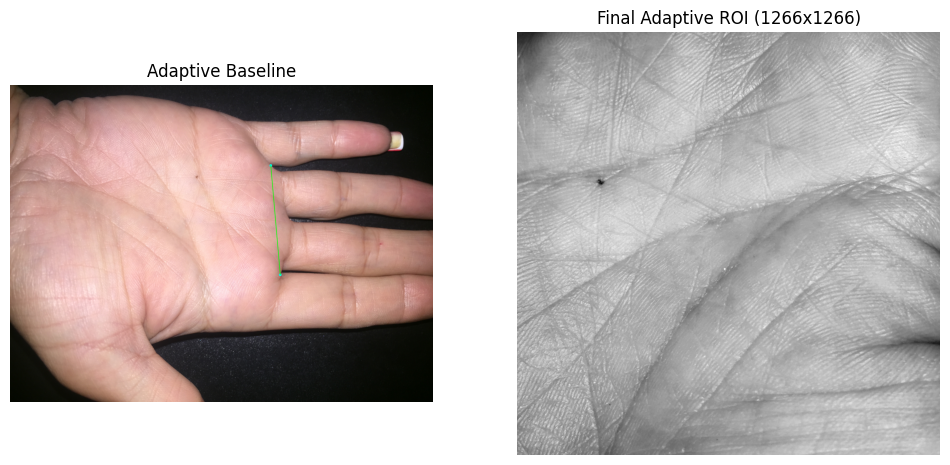

In [10]:
# This code assumes 'final_valley_points', 'original_img', and 'grayscale_img' exist.

if len(final_valley_points) >= 4:
    # 1. Sort points and select the two central valleys
    sorted_valleys = sorted(final_valley_points, key=lambda p: p[0])
    point1 = sorted_valleys[1]
    point2 = sorted_valleys[2]

    # 2. Calculate ADAPTIVE ROI size
    distance = math.sqrt((point2[0] - point1[0])**2 + (point2[1] - point1[1])**2)
    roi_size = int(distance * 1.5)

    # --- THIS IS THE CORRECTED LINE ---
    # Explicitly cast the midpoint coordinates to standard integers
    mid_point = (int((point1[0] + point2[0]) / 2), int((point1[1] + point2[1]) / 2))

    # 3. Calculate DYNAMIC crop direction by rotating the image
    angle = math.degrees(math.atan2(point2[1] - point1[1], point2[0] - point1[0]))
    rotation_matrix = cv2.getRotationMatrix2D(mid_point, angle, 1.0)
    rotated_grayscale = cv2.warpAffine(grayscale_img, rotation_matrix, (grayscale_img.shape[1], grayscale_img.shape[0]))

    # 4. Define the crop start point in the center of the ROTATED image
    crop_x_start = mid_point[0] - (roi_size // 2)
    crop_y_start = mid_point[1] + int(roi_size * 0.1)

    # 5. Crop the final ROI from the ROTATED image
    palm_roi = rotated_grayscale[crop_y_start : crop_y_start + roi_size, crop_x_start : crop_x_start + roi_size]

    # --- Visualization ---
    img_with_visuals = original_img.copy()
    cv2.circle(img_with_visuals, point1, 10, [255, 255, 0], -1) # Cyan
    cv2.circle(img_with_visuals, point2, 10, [255, 255, 0], -1) # Cyan
    cv2.line(img_with_visuals, point1, point2, (0, 255, 0), 3) # Green line

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(img_with_visuals, cv2.COLOR_BGR2RGB))
    plt.title('Adaptive Baseline')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(palm_roi, cmap='gray')
    plt.title(f'Final Adaptive ROI ({roi_size}x{roi_size})')
    plt.axis('off')
    plt.show()
else:
    print(f"Error: Expected 4 valley points to extract ROI, but found {len(final_valley_points)}.")

Blok terakhir ini bertujuan untuk menyeragamkan ukuran semua ROI yang telah diekstrak ke sebuah dimensi standar (misalnya, 300x300 pixels).

Langkah ini wajib dilakukan karena model machine learning memerlukan input dengan ukuran yang konsisten dan sama persis. Proses ini menggunakan fungsi cv2.resize untuk mengubah dimensi ROI yang sebelumnya adaptif menjadi ukuran yang tetap.

Hasilnya adalah ROI yang telah dinormalisasi dan siap untuk tahap feature extraction atau untuk dimasukkan ke dalam model.

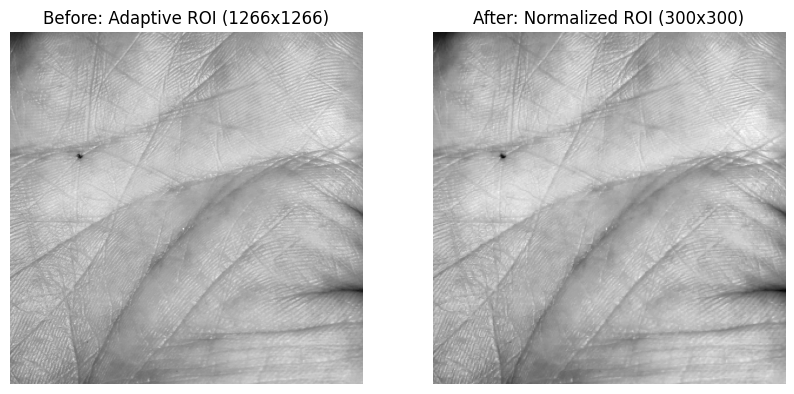

Normalization complete. The ROI is now a standard size, ready for feature extraction.


In [11]:
# --- Final Preprocessing Step: Normalizing the ROI ---

# This block assumes the 'palm_roi' variable from your last successful run exists.

# Define the final, standard size for all ROIs
final_size = (300, 300)

# Check if the ROI is valid before resizing
if 'palm_roi' in locals() and palm_roi is not None and palm_roi.size > 0:
    # Resize the ROI to the standard dimensions
    # cv2.INTER_AREA is a good interpolation method for shrinking images
    normalized_roi = cv2.resize(palm_roi, final_size, interpolation=cv2.INTER_AREA)

    # --- Visualization ---
    plt.figure(figsize=(10, 5))

    plt.subplot(1, 2, 1)
    plt.imshow(palm_roi, cmap='gray')
    plt.title(f'Before: Adaptive ROI ({palm_roi.shape[1]}x{palm_roi.shape[0]})')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(normalized_roi, cmap='gray')
    plt.title(f'After: Normalized ROI ({final_size[0]}x{final_size[1]})')
    plt.axis('off')

    plt.show()

    print("Normalization complete. The ROI is now a standard size, ready for feature extraction.")
else:
    print("Error: The 'palm_roi' variable is not valid. Please re-run the previous block successfully.")

Kode ini bertujuan untuk mengekstrak Region of Interest (ROI) dari gambar telapak tangan.

Proses Kerja

Silhouette & Contour: Mengubah gambar asli menjadi siluet hitam-putih, lalu mendeteksi contour (garis tepi) tangan.

Key Point Detection: Mencoba menemukan key points (lembah antar jari) dengan menganalisis convexity defects pada contour.

ROI Extraction: Membuat baseline antara dua key points tengah, memutar gambar agar baseline lurus, lalu memotong ROI dari area telapak tangan.

In [37]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import math
import os

def process_palm_image(image_path, final_size=(150, 150), visualize=False):
    """
    Processes a palm image to a normalized ROI and can display all processing
    stages in a single, consolidated plot for visualization.
    """
    if visualize:
        print(f"--- Processing: {os.path.basename(image_path)} ---")

    # --- Step 1: Load Image and Create Silhouette ---
    original_img = cv2.imread(image_path)
    if original_img is None: return None

    grayscale_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2GRAY)
    ret, silhouette_img = cv2.threshold(grayscale_img, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # --- Step 2: Find and Simplify the Contour ---
    contours, _ = cv2.findContours(silhouette_img, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours: return None

    hand_contour = max(contours, key=cv2.contourArea)
    epsilon = 0.001 * cv2.arcLength(hand_contour, True)
    hand_contour = cv2.approxPolyDP(hand_contour, epsilon, True)

    # --- Step 3: Find Key Valley Points ---
    try:
        M = cv2.moments(hand_contour)
        if M["m00"] == 0: return None

        rect = cv2.minAreaRect(hand_contour)
        (cx, cy), (width, height), angle = rect
        hull_indices = cv2.convexHull(hand_contour, returnPoints=False)
        defects = cv2.convexityDefects(hand_contour, hull_indices)
        if defects is None: return None

        potential_valleys = []
        # (Valley finding logic remains the same)
        rot_matrix = cv2.getRotationMatrix2D((cx, cy), angle, 1.0)
        positional_tolerance = height * 0.4
        for i in range(defects.shape[0]):
            s, e, f, d = defects[i, 0]
            far = tuple(hand_contour[f][0])
            start_pt, end_pt = tuple(hand_contour[s][0]), tuple(hand_contour[e][0])
            a, b, c = (math.sqrt((end_pt[0] - start_pt[0])**2 + (end_pt[1] - start_pt[1])**2),
                       math.sqrt((far[0] - start_pt[0])**2 + (far[1] - start_pt[1])**2),
                       math.sqrt((end_pt[0] - far[0])**2 + (end_pt[1] - far[1])**2))
            angle_defect = math.acos((b**2 + c**2 - a**2) / (2*b*c)) * 180 / np.pi if (2*b*c) > 0 else 0
            if angle_defect <= 90:
                far_point_mat = np.array([[[far[0], far[1]]]], dtype=np.float32)
                rotated_point = cv2.transform(far_point_mat, rot_matrix)[0][0]
                if rotated_point[1] < cy + positional_tolerance:
                    potential_valleys.append((far, d))

        potential_valleys.sort(key=lambda item: item[1], reverse=True)
        final_valley_points = [item[0] for item in potential_valleys[:4]]

        # --- Step 4 & 5: Extract and Normalize ROI ---
        if len(final_valley_points) < 4: return None

        sorted_valleys = sorted(final_valley_points, key=lambda p: p[0])
        point1, point2 = sorted_valleys[1], sorted_valleys[2]
        distance = math.sqrt((point2[0] - point1[0])**2 + (point2[1] - point1[1])**2)
        roi_size = int(distance * 1.5)
        mid_point = (int((point1[0] + point2[0]) / 2), int((point1[1] + point2[1]) / 2))
        roi_angle = math.degrees(math.atan2(point2[1] - point1[1], point2[0] - point1[0]))
        rotation_matrix = cv2.getRotationMatrix2D(mid_point, roi_angle, 1.0)
        rotated_grayscale = cv2.warpAffine(grayscale_img, rotation_matrix, (grayscale_img.shape[1], grayscale_img.shape[0]))
        crop_x_start = mid_point[0] - (roi_size // 2)
        crop_y_start = mid_point[1] + int(roi_size * 0.1)
        palm_roi = rotated_grayscale[crop_y_start : crop_y_start + roi_size, crop_x_start : crop_x_start + roi_size]
        if palm_roi.size == 0: return None

        normalized_roi = cv2.resize(palm_roi, final_size, interpolation=cv2.INTER_AREA)

        # --- NEW CONSOLIDATED VISUALIZATION ---
        if visualize:
            # Create canvases for each step
            contour_canvas = np.zeros_like(grayscale_img)
            cv2.drawContours(contour_canvas, [hand_contour], -1, 255, 3)

            key_points_canvas = original_img.copy()
            for point in final_valley_points:
                cv2.circle(key_points_canvas, point, 15, [0, 0, 255], -1)

            baseline_canvas = original_img.copy()
            cv2.circle(baseline_canvas, point1, 15, [255, 255, 0], -1)
            cv2.circle(baseline_canvas, point2, 15, [255, 255, 0], -1)
            cv2.line(baseline_canvas, point1, point2, (0, 255, 0), 3)

            # Create a single figure with 5 subplots
            fig, axes = plt.subplots(1, 5, figsize=(20, 4))

            axes[0].imshow(silhouette_img, cmap='gray'); axes[0].set_title('1. Silhouette'); axes[0].axis('off')
            axes[1].imshow(contour_canvas, cmap='gray'); axes[1].set_title('2. Contour'); axes[1].axis('off')
            axes[2].imshow(cv2.cvtColor(key_points_canvas, cv2.COLOR_BGR2RGB)); axes[2].set_title('3. Key Points'); axes[2].axis('off')
            axes[3].imshow(cv2.cvtColor(baseline_canvas, cv2.COLOR_BGR2RGB)); axes[3].set_title('4. Baseline'); axes[3].axis('off')
            axes[4].imshow(normalized_roi, cmap='gray'); axes[4].set_title(f'5. Final ROI {final_size}'); axes[4].axis('off')

            plt.suptitle(f'Processing Steps for {os.path.basename(image_path)}', fontsize=16)
            plt.tight_layout(rect=[0, 0, 1, 0.95])
            plt.show()

        return normalized_roi

    except cv2.error as e:
        if visualize: print(f"An OpenCV error occurred: {e}")
        return None

--- Starting quick test on 10 images from one folder ---
Processing image 1/10: 001_F_0.JPG...
--- Processing: 001_F_0.JPG ---


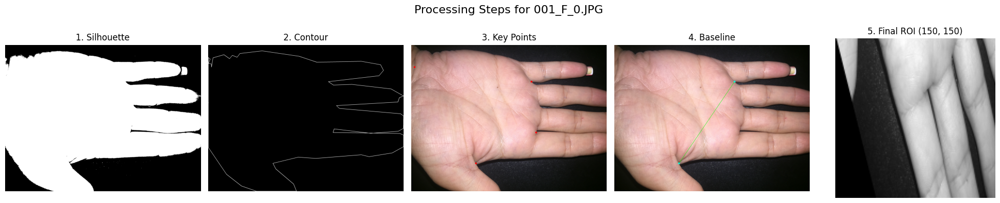

Processing image 2/10: 001_F_1.JPG...
--- Processing: 001_F_1.JPG ---


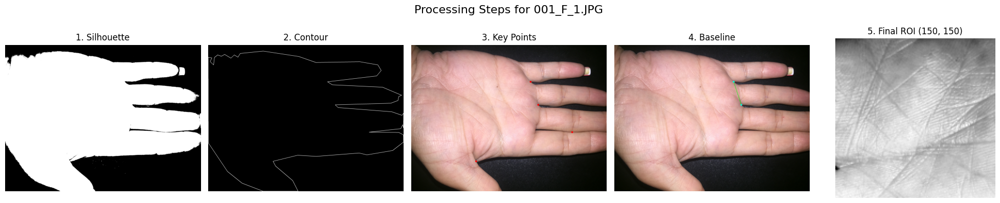

Processing image 3/10: 001_F_2.JPG...
--- Processing: 001_F_2.JPG ---


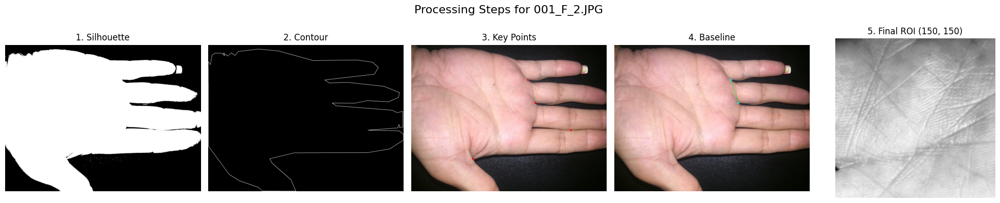

Processing image 4/10: 001_F_3.JPG...
--- Processing: 001_F_3.JPG ---


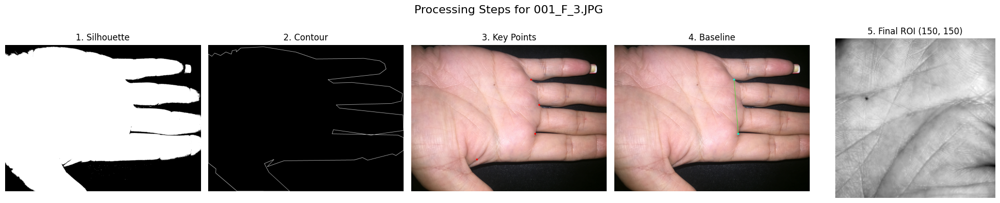

Processing image 5/10: 001_F_4.JPG...
--- Processing: 001_F_4.JPG ---


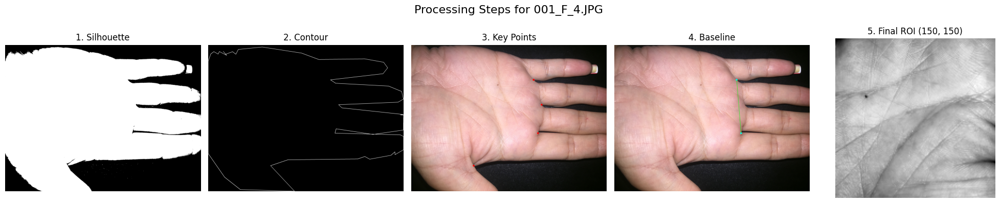

Processing image 6/10: 001_F_5.JPG...
--- Processing: 001_F_5.JPG ---


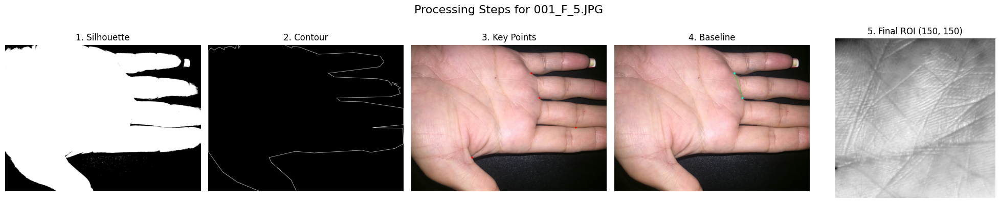

Processing image 7/10: 001_F_6.JPG...
--- Processing: 001_F_6.JPG ---


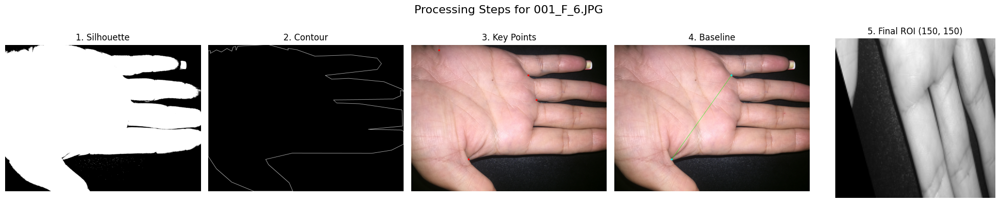

Processing image 8/10: 001_F_7.JPG...
--- Processing: 001_F_7.JPG ---


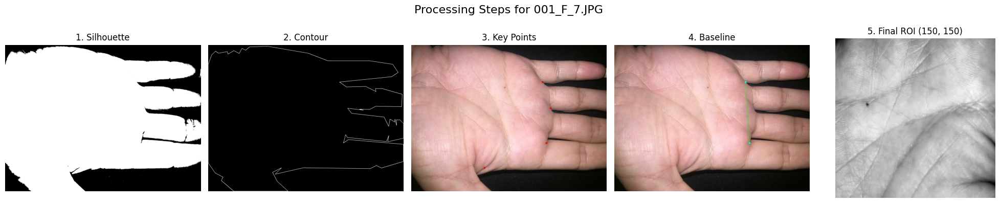

Processing image 9/10: 001_F_8.JPG...
--- Processing: 001_F_8.JPG ---
Processing image 10/10: 001_F_9.JPG...
--- Processing: 001_F_9.JPG ---


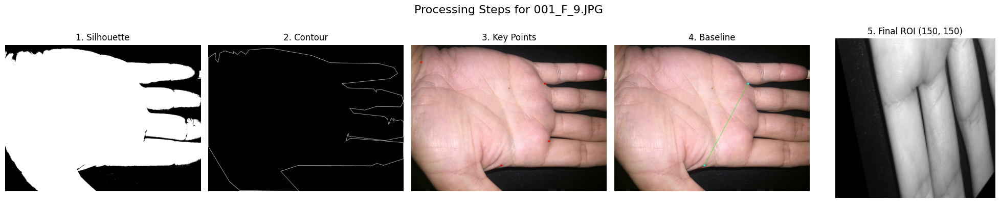


--- Quick Test Complete ---
Successfully processed 9 out of 10 images.


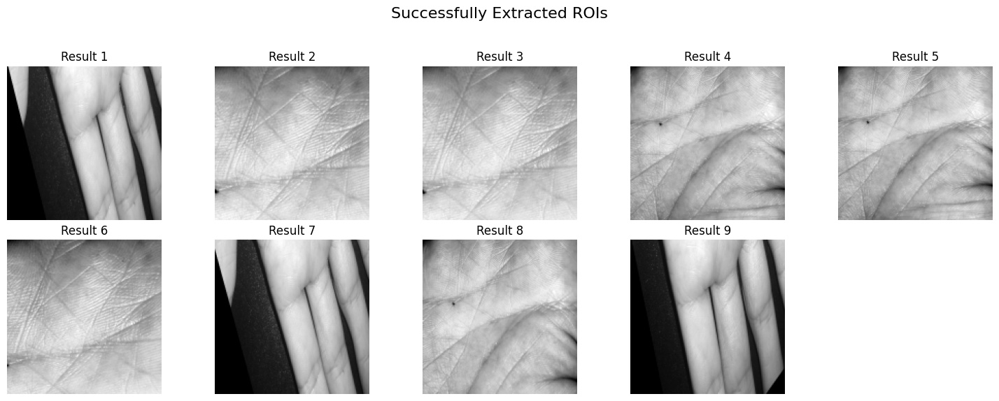

In [20]:
import os
import matplotlib.pyplot as plt

# --- Quick Test on a Single Directory ---

# Define the specific directory you listed
test_directory = "/content/drive/MyDrive/datasets/smpd/Sapienza University Mobile Palmprint Database(SMPD)/001/"

# Create the list of the 10 filenames from your 'ls' output
# This avoids a slow 'glob' search
filenames = [f"001_F_{i}.JPG" for i in range(10)]
images_to_test = [os.path.join(test_directory, f) for f in filenames]

print(f"--- Starting quick test on {len(images_to_test)} images from one folder ---")

# --- Loop through the test images and process them ---
processed_rois = []
for i, path in enumerate(images_to_test):
    print(f"Processing image {i+1}/{len(images_to_test)}: {os.path.basename(path)}...")

    # Call our master function with visualization turned OFF
    roi = process_palm_image(path, visualize=True)

    # If processing was successful, add the result to our list
    if roi is not None:
        processed_rois.append(roi)

print(f"\n--- Quick Test Complete ---")
print(f"Successfully processed {len(processed_rois)} out of {len(images_to_test)} images.")

# --- Visualize the successful results in a grid ---
if processed_rois:
    num_rois = len(processed_rois)
    cols = 5
    rows = (num_rois + cols - 1) // cols # Calculate rows needed

    plt.figure(figsize=(15, 3 * rows))
    for i, roi in enumerate(processed_rois):
        plt.subplot(rows, cols, i + 1)
        plt.imshow(roi, cmap='gray')
        plt.title(f'Result {i+1}')
        plt.axis('off')

    plt.suptitle('Successfully Extracted ROIs', fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

Analisis Metode

Karena metode berbasis key point dan convexity defects ini seringkali memberikan hasil yang tidak stabil (defect dan unreliable), pendekatan yang lebih baik adalah mengganti metode pencarian ROI dari berbasis key point menjadi mencari centroid (titik pusat) dari contour tangan dan memotong area di sekitarnya. Metode centroid jauh lebih robust.

# Ekstraksi ROI Berbasis Center Point

- Menemukan Titik Pusat: Kode menghitung centroid (titik pusat geometris) dari contour tangan.
- Memotong ROI Besar: Sebuah area besar berukuran 1000x1000 pixels dipotong (crop) dari gambar asli, dengan centroid sebagai titik tengahnya.
- Normalisasi Ukuran: ROI besar yang telah dipotong kemudian diubah ukurannya menjadi ukuran akhir yang standar (misalnya 150x150) menggunakan cv2.resize

In [43]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import os

def process_palm_image(image_path, final_size=(150, 150), visualize=False):
    """
    Extracts a large 1000x1000 ROI centered on the palm and resizes it to the final_size.
    """
    if visualize:
        print(f"--- Processing: {os.path.basename(image_path)} ---")

    try:
        # Step 1 & 2: Get a clean contour of the hand
        original_img = cv2.imread(image_path)
        if original_img is None: return None

        grayscale_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2GRAY)

        # Blur before thresholding to get a clean silhouette
        blurred_img = cv2.GaussianBlur(grayscale_img, (11, 11), 0)
        _, silhouette_img = cv2.threshold(blurred_img, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

        # Morphological operations to further clean the shape
        kernel = np.ones((5, 5), np.uint8)
        cleaned_silhouette = cv2.morphologyEx(silhouette_img, cv2.MORPH_CLOSE, kernel)
        cleaned_silhouette = cv2.morphologyEx(cleaned_silhouette, cv2.MORPH_OPEN, kernel)

        contours, _ = cv2.findContours(cleaned_silhouette, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        if not contours: return None
        hand_contour = max(contours, key=cv2.contourArea)

        # --- Step 3: DIRECT ROI EXTRACTION ---

        # 1. Find the geometric center (centroid) of the palm
        M = cv2.moments(hand_contour)
        if M["m00"] == 0: return None
        cx = int(M["m10"] / M["m00"])
        cy = int(M["m01"] / M["m00"])

        # 2. Define the large initial crop size, as requested
        initial_crop_size = 1000

        # 3. Define the crop box for the large ROI
        x_start = cx - (initial_crop_size // 2)
        y_start = cy - (initial_crop_size // 2)
        x_end = x_start + initial_crop_size
        y_end = y_start + initial_crop_size

        # Check if the crop box is within the image boundaries
        h, w = grayscale_img.shape
        if not (0 <= y_start < y_end <= h and 0 <= x_start < x_end <= w):
             return None # Crop is out of bounds

        # 4. Crop the large 1000x1000 ROI from the original grayscale image
        large_roi = grayscale_img[y_start:y_end, x_start:x_end]

        # 5. Resize the large ROI down to the final target size (e.g., 150x150)
        normalized_roi = cv2.resize(large_roi, final_size, interpolation=cv2.INTER_AREA)

        if visualize:
            # Visualization code
            contour_canvas = np.zeros_like(grayscale_img)
            cv2.drawContours(contour_canvas, [hand_contour], -1, 255, 4)

            crop_box_canvas = original_img.copy()
            cv2.circle(crop_box_canvas, (cx, cy), 15, (0, 0, 255), -1)
            cv2.rectangle(crop_box_canvas, (x_start, y_start), (x_end, y_end), (0, 255, 0), 3)

            fig, axes = plt.subplots(1, 5, figsize=(20, 4))
            axes[0].imshow(cleaned_silhouette, cmap='gray'); axes[0].set_title('1. Silhouette'); axes[0].axis('off')
            axes[1].imshow(contour_canvas, cmap='gray'); axes[1].set_title('2. Contour'); axes[1].axis('off')
            axes[2].imshow(cv2.cvtColor(crop_box_canvas, cv2.COLOR_BGR2RGB)); axes[2].set_title('3. Center & 1000x1000 Box'); axes[2].axis('off')
            axes[3].imshow(large_roi, cmap='gray'); axes[3].set_title('4. Large ROI (1000x1000)'); axes[3].axis('off')
            axes[4].imshow(normalized_roi, cmap='gray'); axes[4].set_title(f'5. Final ROI {final_size}'); axes[4].axis('off')
            plt.suptitle(f'Processing Steps for {os.path.basename(image_path)}', fontsize=16)
            plt.tight_layout(rect=[0, 0, 1, 0.95])
            plt.show()

        return normalized_roi

    except Exception:
        return None

--- Starting batch test on 20 images ---
--- Processing: 001_F_0.JPG ---


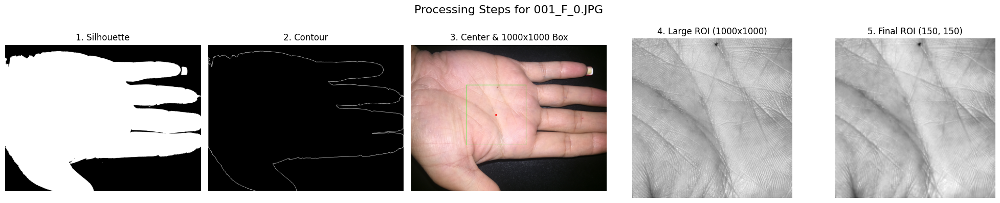

--- Processing: 001_RF_10.JPG ---


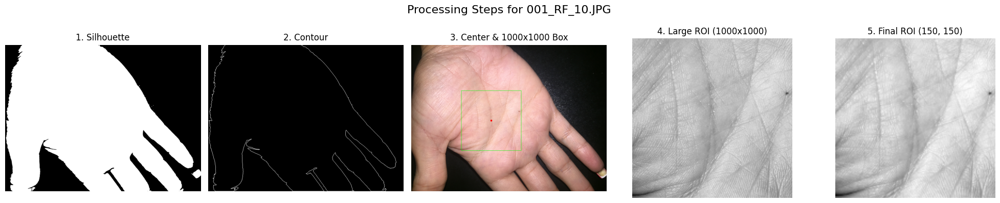

--- Processing: 001_P_20.JPG ---


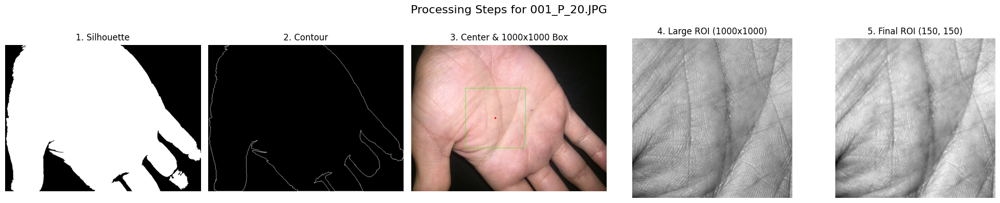

--- Processing: 001_RP_30.JPG ---


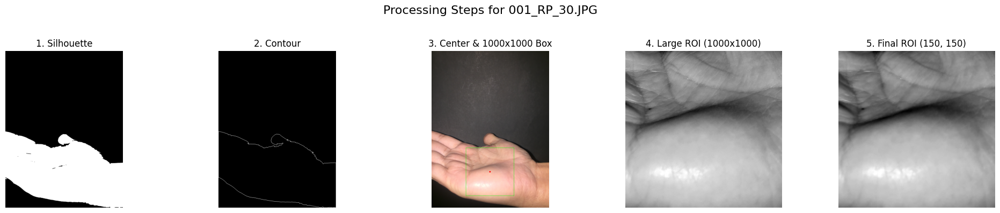

--- Processing: 002_F_0.JPG ---


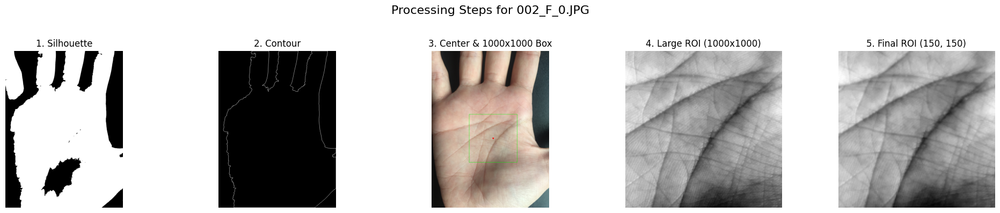

--- Processing: 002_RF_10.JPG ---


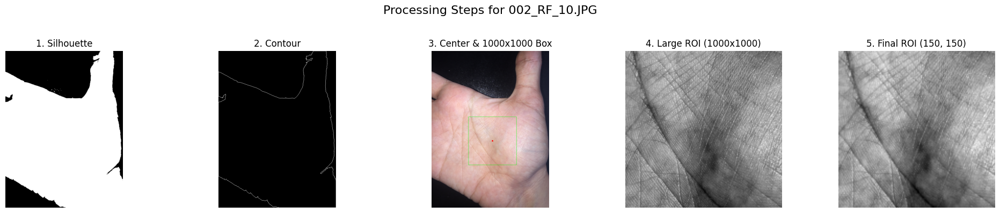

--- Processing: 002_P_20.JPG ---


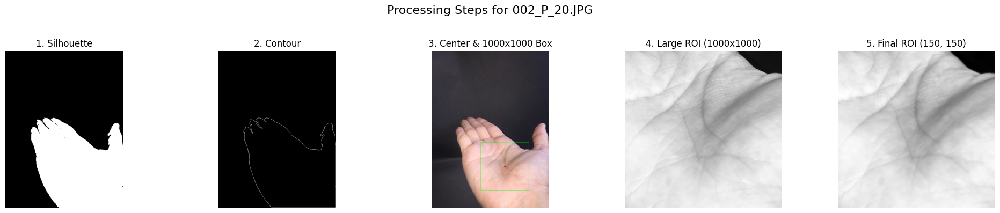

--- Processing: 002_RP_30.JPG ---


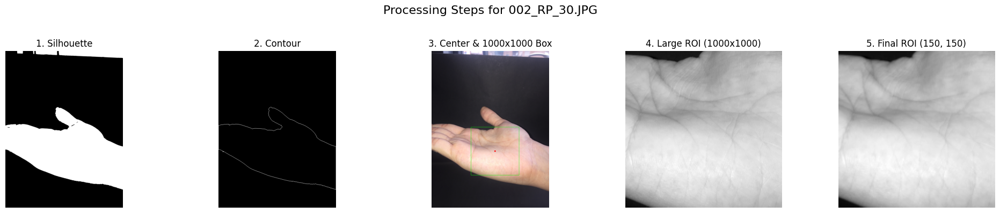

--- Processing: 003_F_0.JPG ---


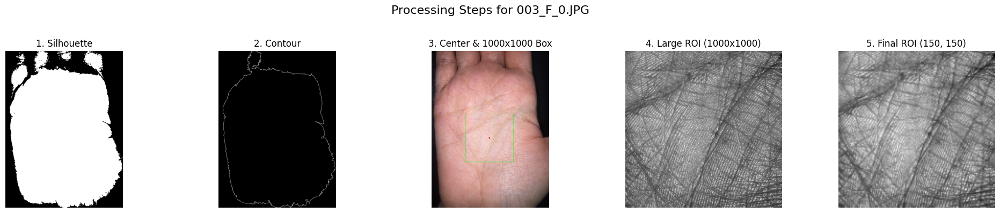

--- Processing: 003_RF_10.JPG ---


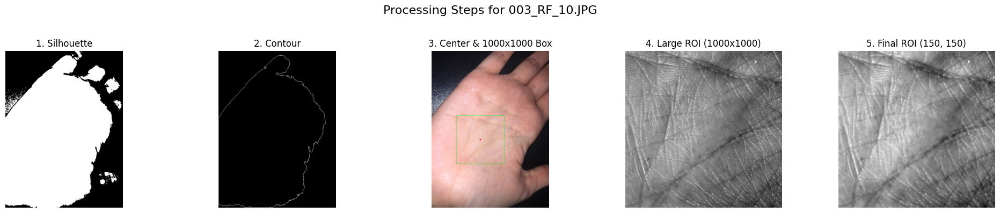

--- Processing: 003_P_20.JPG ---


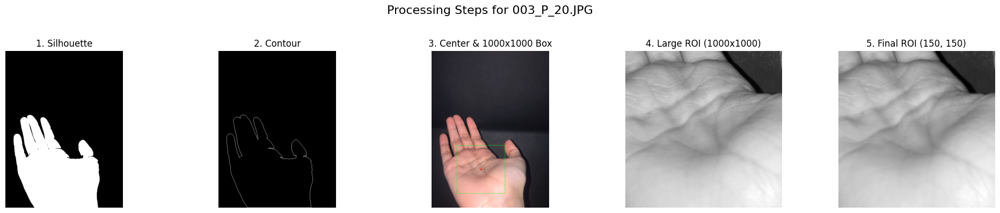

--- Processing: 003_RP_30.JPG ---


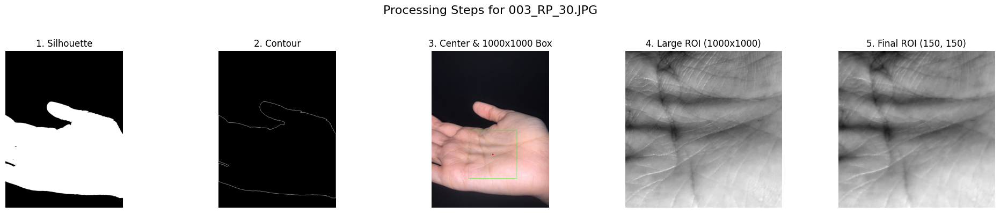

--- Processing: 004_F_0.JPG ---


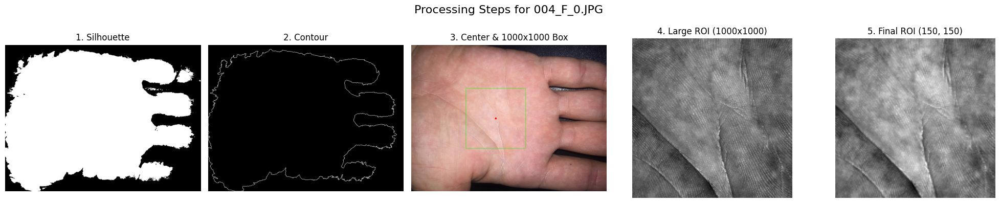

--- Processing: 004_RF_10.JPG ---


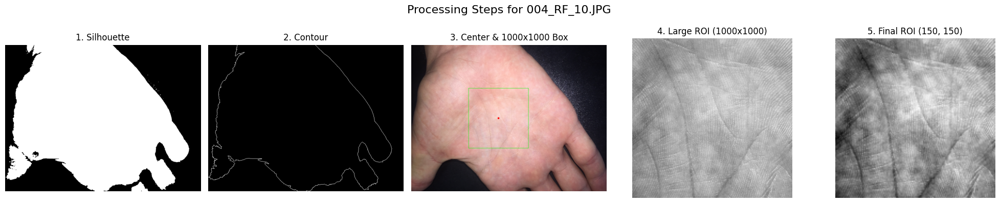

--- Processing: 004_P_20.JPG ---


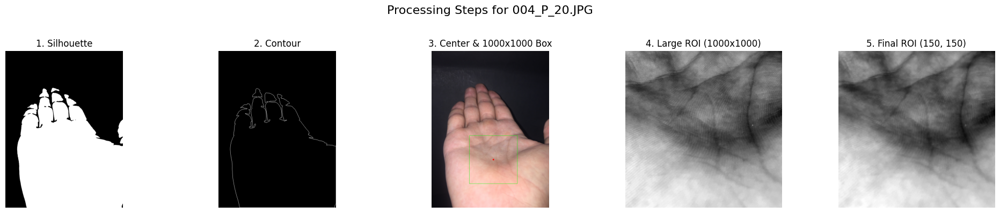

--- Processing: 004_RP_30.JPG ---


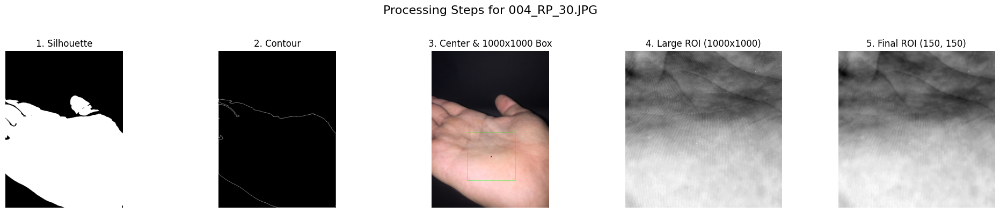

--- Processing: 005_F_0.JPG ---


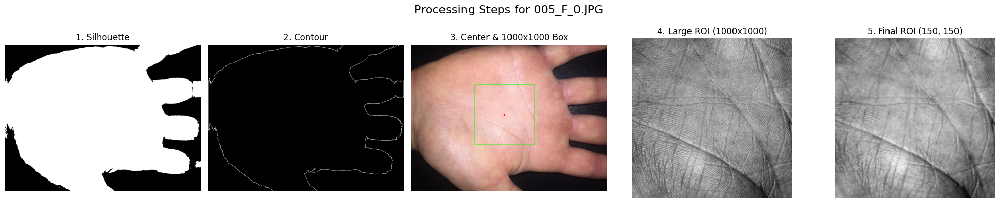

--- Processing: 005_RF_10.JPG ---


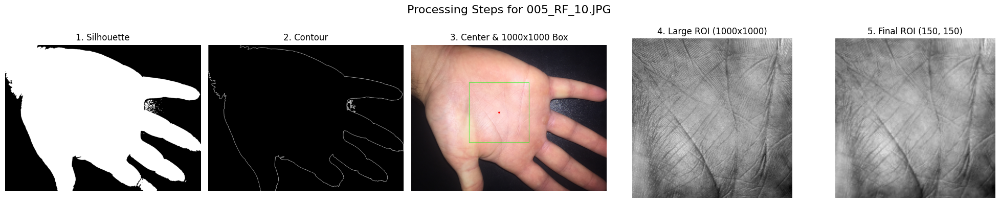

--- Processing: 005_P_20.JPG ---


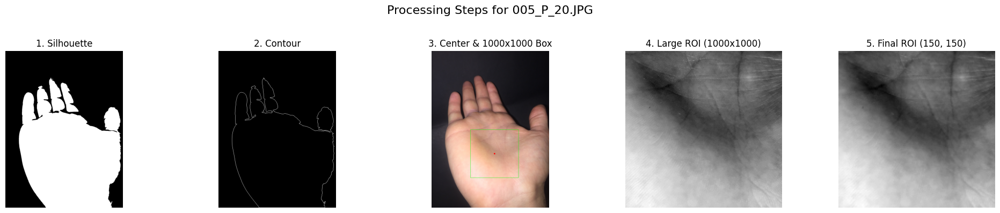

--- Processing: 005_RP_30.JPG ---


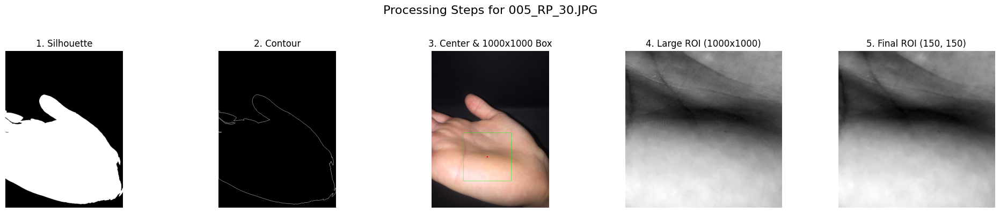


--- Batch Test Complete ---
Successfully processed 20 out of 20 images.


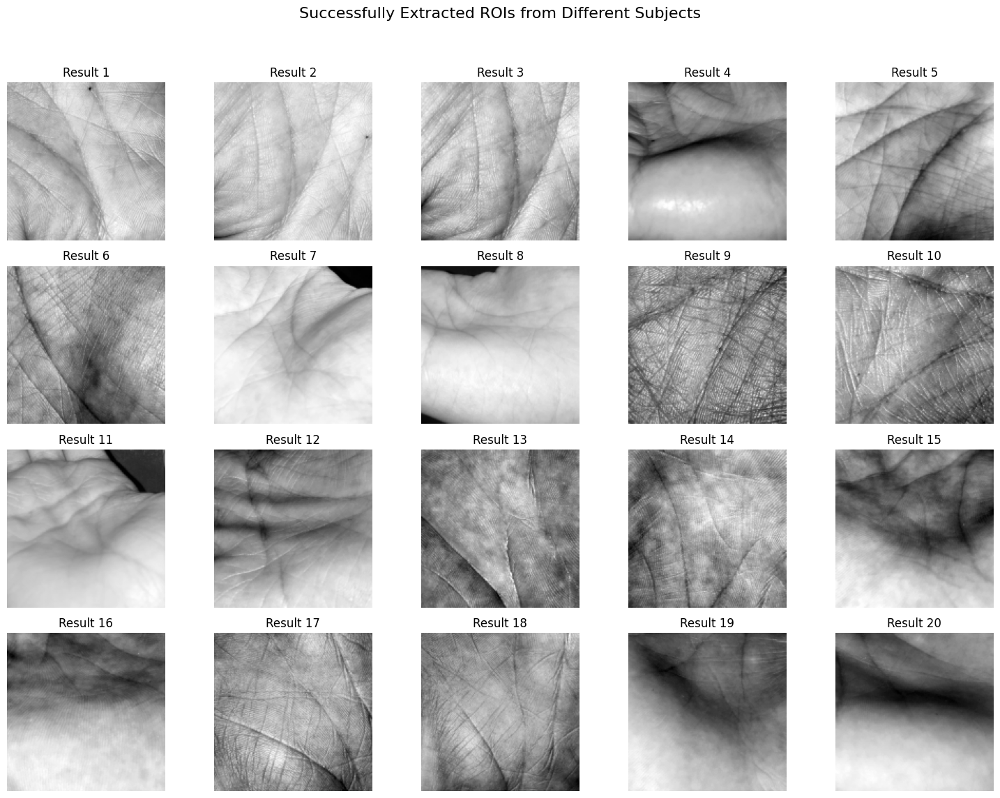

In [44]:
import os
import matplotlib.pyplot as plt
# Assume process_palm_image is defined elsewhere in your code

# --- Testing Script ---
# Define the base directory for the dataset
base_directory = "/content/drive/MyDrive/datasets/smpd/Sapienza University Mobile Palmprint Database(SMPD)/"

# --- MODIFICATION START ---
# Build the list of images to test
images_to_test = []
# Define the specific image suffixes to grab from each subject's folder
image_suffixes = ['F_0', 'RF_10', 'P_20', 'RP_30']

for i in range(1, 6):  # For subjects 001 to 010
    subject_id = str(i).zfill(3)
    subject_folder = os.path.join(base_directory, subject_id)

    # Loop through the desired image suffixes for the current subject
    for suffix in image_suffixes:
        image_filename = f"{subject_id}_{suffix}.JPG"
        full_path = os.path.join(subject_folder, image_filename)
        images_to_test.append(full_path)
# --- MODIFICATION END ---


print(f"--- Starting batch test on {len(images_to_test)} images ---")

processed_rois = []
for path in images_to_test:
    # Call our master function. Set visualize=True to see detailed plots for each.
    roi = process_palm_image(path, visualize=True) # Set to False for cleaner batch output

    if roi is not None:
        processed_rois.append(roi)

print(f"\n--- Batch Test Complete ---")
print(f"Successfully processed {len(processed_rois)} out of {len(images_to_test)} images.")

# Visualize the successful results in a grid
if processed_rois:
    num_rois = len(processed_rois)
    cols = 5
    rows = (num_rois + cols - 1) // cols

    plt.figure(figsize=(15, 3 * rows))
    for i, roi in enumerate(processed_rois):
        plt.subplot(rows, cols, i + 1)
        plt.imshow(roi, cmap='gray')
        plt.title(f'Result {i+1}')
        plt.axis('off')

    plt.suptitle('Successfully Extracted ROIs from Different Subjects', fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

Blok ini membuat sebuah subset dataset dengan memilih sejumlah gambar dari beberapa subjek yang telah ditentukan.

Kode ini melakukan looping untuk memanggil fungsi process_palm_image pada setiap file gambar. Region of Interest (ROI) dan label (ID subjek) yang berhasil diekstrak kemudian dikumpulkan.

Hasil akhirnya adalah dua NumPy array, all_rois (berisi gambar) dan all_labels (berisi identitas), yang siap digunakan untuk tahap training dan testing.

In [58]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import math
import os
import glob
from tqdm import tqdm


# --- Select and Process the Small Dataset ---
dataset_path = "/content/drive/MyDrive/datasets/smpd/Sapienza University Mobile Palmprint Database(SMPD)/"
people_to_include = ['001', '002', '003', '004', '005']
images_per_person = 10

all_rois = []
all_labels = []

for person_id in tqdm(people_to_include, desc="Processing People"):
    person_dir = os.path.join(dataset_path, person_id)
    image_files = sorted(glob.glob(os.path.join(person_dir, "*.JPG")))[:images_per_person]

    for file_path in image_files:
        roi = process_palm_image(file_path, final_size=(150, 150))
        if roi is not None:
            all_rois.append(roi)
            all_labels.append(person_id)

all_rois = np.array(all_rois)
all_labels = np.array(all_labels)

print(f"\nSuccessfully processed {len(all_rois)} images for {len(people_to_include)} people.")

Processing People: 100%|██████████| 5/5 [00:05<00:00,  1.15s/it]


Successfully processed 50 images for 5 people.


Blok kode ini membagi dataset yang telah diproses menjadi dua set terpisah: training set dan testing set.

In [59]:
X_train, y_train = [], []
X_test, y_test = [], []

for person_id in people_to_include:
    indices = np.where(all_labels == person_id)[0]

    # Use 8 images per person for training
    for i in indices[:8]:
        X_train.append(all_rois[i])
        y_train.append(all_labels[i])

    # Use 2 images per person for testing
    for i in indices[8:]:
        X_test.append(all_rois[i])
        y_test.append(all_labels[i])

X_train = np.array(X_train)
y_train = np.array(y_train)
X_test = np.array(X_test)
y_test = np.array(y_test)

# Preprocess ROIs for the model
X_train = X_train.astype('float32') / 255.0
X_test = X_test.astype('float32') / 255.0
X_train = np.expand_dims(X_train, axis=-1)
X_test = np.expand_dims(X_test, axis=-1)

print(f"Training set size: {len(X_train)} images")
print(f"Testing set size: {len(X_test)} images")

Training set size: 40 images
Testing set size: 10 images


# Test Model dengan Sample Data
Blok kode ini adalah inti dari proyek machine learning, yang mencakup semua langkah mulai dari mendefinisikan arsitektur model hingga melatihnya dan memvisualisasikan hasilnya.

Model Definition: Bagian ini mendefinisikan tiga komponen utama:

>create_base_network: Fungsi ini membangun sebuah arsitektur CNN dasar yang bertugas mengubah gambar ROI menjadi sebuah feature vector (representasi numerik dari fitur-fitur unik telapak)

>euclidean_distance: Fungsi untuk menghitung jarak matematis antara dua feature

>contrastive_loss: Ini adalah fungsi loss khusus yang menjadi "otak" dari proses belajar. Tujuannya adalah untuk "memaksa" model menghasilkan jarak yang kecil untuk pasangan gambar dari orang yang sama, dan jarak yang besar untuk pasangan gambar dari orang yang berbeda.

Data Preparation for Training: Fungsi create_pairs mengambil training set dan secara acak membuat pasangan-pasangan

>Positive Pairs: Dua gambar berbeda dari orang yang sama (diberi label 1.0).

>Negative Pairs: Dua gambar dari orang yang berbeda (diberi label 0.0).
    Model akan belajar dari pasangan-pasangan ini.

Build and Train the Model: Kode ini merakit semua komponen menjadi sebuah Siamese Network. Model ini memiliki dua input (untuk sepasang gambar) yang diproses oleh base network yang identik, dan satu output yang merupakan jarak antara keduanya. Model kemudian di-compile dan dilatih menggunakan siamese_model.fit() pada data pasangan yang telah dibuat.


--- Starting Model Training ---
Epoch 1/15
5/5 ━━━━━━━━━━━━━━━━━━━━ 4s 442ms/step - loss: 0.3302 - val_loss: 0.0991
Epoch 2/15
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - loss: 0.0655 - val_loss: 0.2417
Epoch 3/15
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - loss: 0.0521 - val_loss: 0.2043
Epoch 4/15
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - loss: 0.0370 - val_loss: 0.1346
Epoch 5/15
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - loss: 0.0203 - val_loss: 0.0834
Epoch 6/15
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step - loss: 0.0087 - val_loss: 0.0605
Epoch 7/15
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - loss: 0.0065 - val_loss: 0.0509
Epoch 8/15
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - loss: 0.0058 - val_loss: 0.0502
Epoch 9/15
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - loss: 0.0035 - val_loss: 0.0537
Epoch 10/15
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - loss: 0.0012 - val_loss: 0.0577
Epoch 11/15
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step - loss: 0.0011 - val_loss: 0.0624
Epoch 12/15
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step -

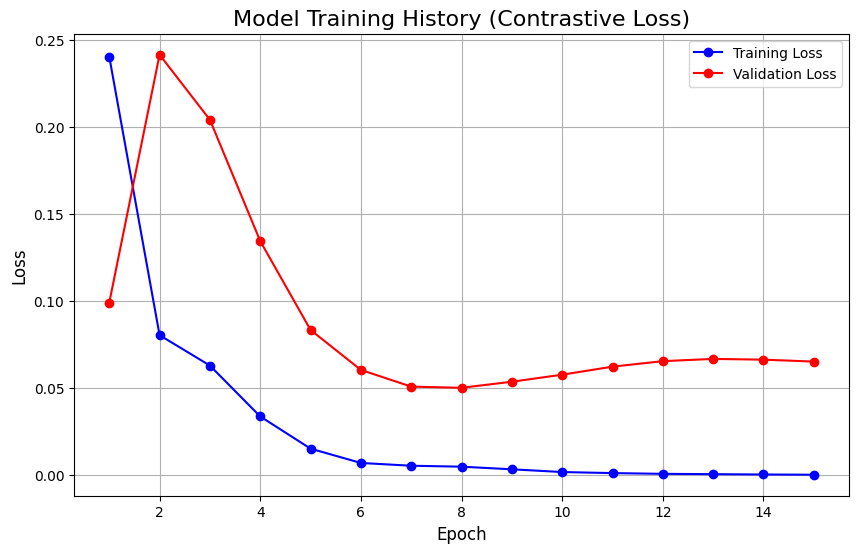

In [60]:
import random
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Flatten, Dense, Lambda
from tensorflow.keras.optimizers import Adam
import tensorflow.keras.backend as K

# --- Model Definition ---
def create_base_network(input_shape):
    input_layer = Input(shape=input_shape)
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(input_layer)
    x = MaxPooling2D()(x)
    x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
    x = MaxPooling2D()(x)
    x = Flatten()(x)
    x = Dense(256, activation='relu')(x)
    return Model(input_layer, x)

def euclidean_distance(vects):
    x, y = vects
    sum_square = K.sum(K.square(x - y), axis=1, keepdims=True)
    return K.sqrt(K.maximum(sum_square, K.epsilon()))

def contrastive_loss(y_true, y_pred):
    margin = 1.0
    square_pred = K.square(y_pred)
    margin_square = K.square(K.maximum(margin - y_pred, 0))
    return K.mean(y_true * tf.cast(square_pred, tf.float32) + (1 - y_true) * tf.cast(margin_square, tf.float32))

# --- Data Preparation for Training ---
def create_pairs(x, y):
    pairs, pair_labels = [], []
    label_to_indices = {label: np.where(y == label)[0] for label in np.unique(y)}
    for i in range(len(x)):
        current_image, current_label = x[i], y[i]
        if random.random() > 0.5:
            idx2 = random.choice([j for j in label_to_indices[current_label] if j != i])
            other_image = x[idx2]
            pairs.append([current_image, other_image]); pair_labels.append(1.0)
        else:
            other_label = random.choice([l for l in label_to_indices if l != current_label])
            idx2 = random.choice(label_to_indices[other_label])
            other_image = x[idx2]
            pairs.append([current_image, other_image]); pair_labels.append(0.0)
    return np.array(pairs), np.array(pair_labels)

train_pairs, train_labels = create_pairs(X_train, y_train)

# --- Build and Compile the Model ---
image_shape = X_train.shape[1:]
base_network = create_base_network(image_shape)
input_a, input_b = Input(shape=image_shape), Input(shape=image_shape)
processed_a, processed_b = base_network(input_a), base_network(input_b)
distance = Lambda(euclidean_distance)([processed_a, processed_b])
siamese_model = Model([input_a, input_b], distance)
siamese_model.compile(loss=contrastive_loss, optimizer=Adam(learning_rate=0.0001))

# --- Train the Model ---
print("\n--- Starting Model Training ---")
history = siamese_model.fit(
    [train_pairs[:, 0], train_pairs[:, 1]],
    train_labels,
    epochs=15,
    batch_size=8,
    validation_split=0.1
)
print("--- Model Training Complete ---")

# --- Visualize Training History ---
print("\n--- Generating Training History Plot ---")
training_loss = history.history['loss']
validation_loss = history.history['val_loss']
epochs = range(1, len(training_loss) + 1)
plt.figure(figsize=(10, 6))
plt.plot(epochs, training_loss, 'bo-', label='Training Loss')
plt.plot(epochs, validation_loss, 'ro-', label='Validation Loss')
plt.title('Model Training History (Contrastive Loss)', fontsize=16)
plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.legend()
plt.grid(True)
plt.show()

--- Creating a reference gallery of known users... ---
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step
Gallery created with 5 authorized personnel.

--- Running Evaluation on the Entire Test Set ---

--- Test 1/10 ---
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step


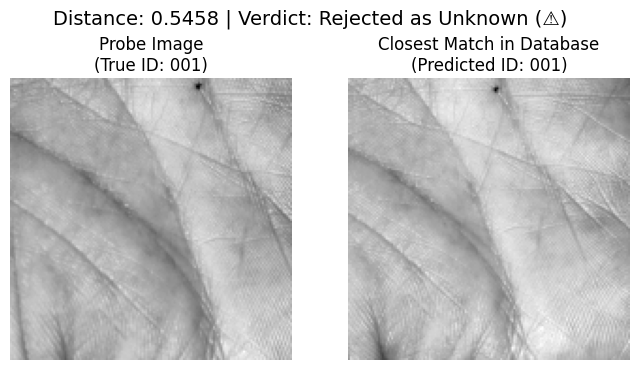


--- Test 2/10 ---
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


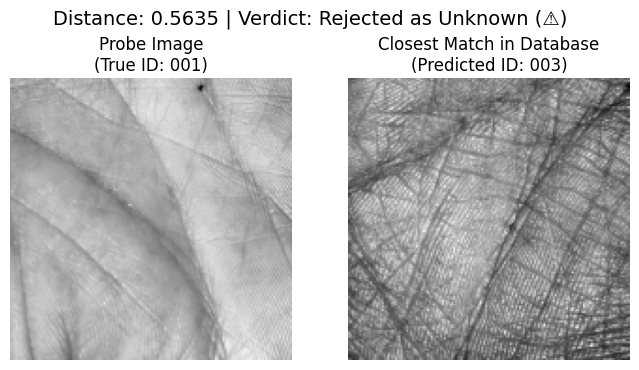


--- Test 3/10 ---
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


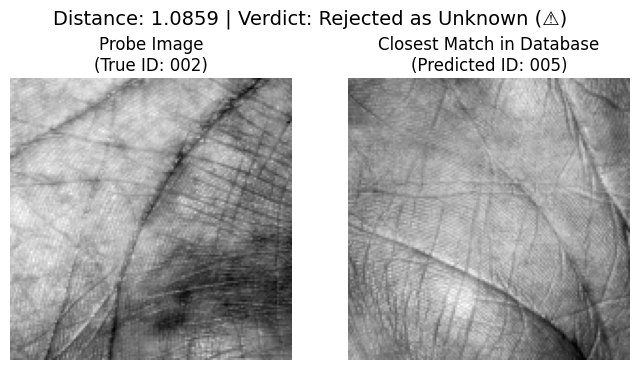


--- Test 4/10 ---
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


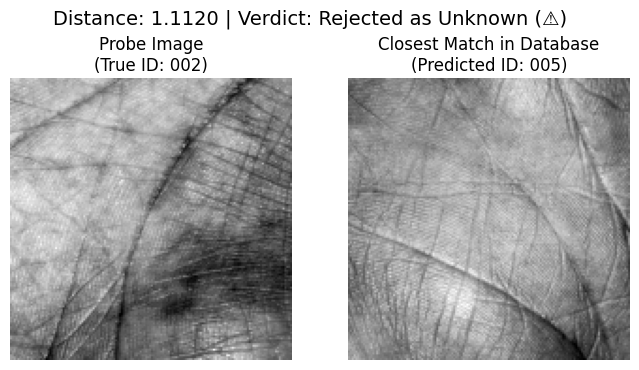


--- Test 5/10 ---
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


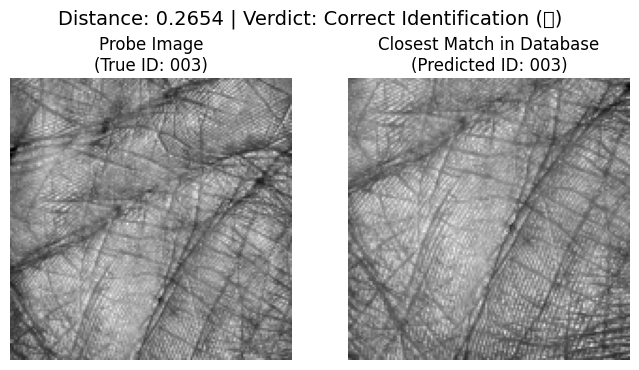


--- Test 6/10 ---
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


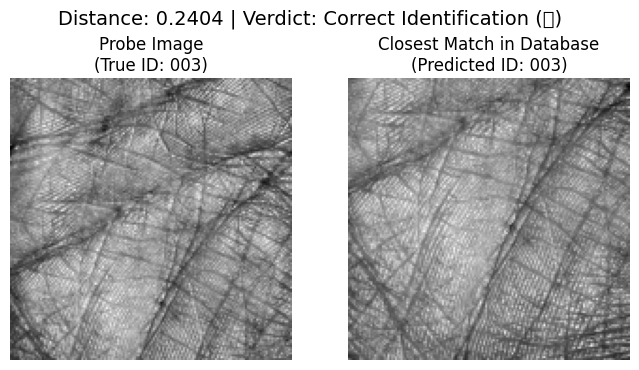


--- Test 7/10 ---
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


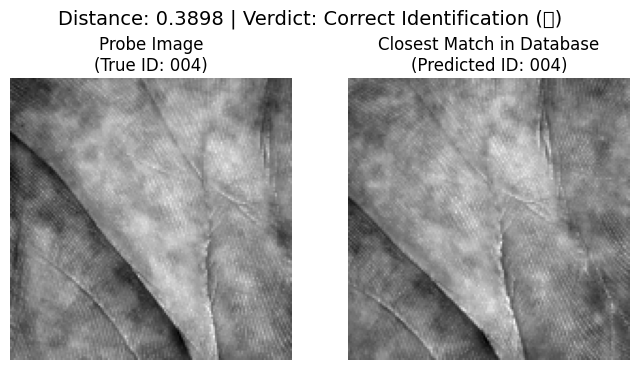


--- Test 8/10 ---
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


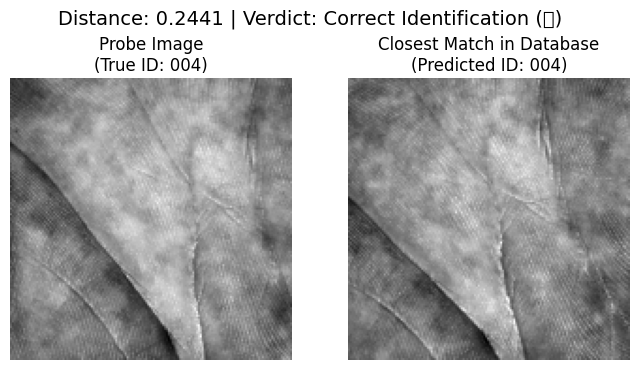


--- Test 9/10 ---
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


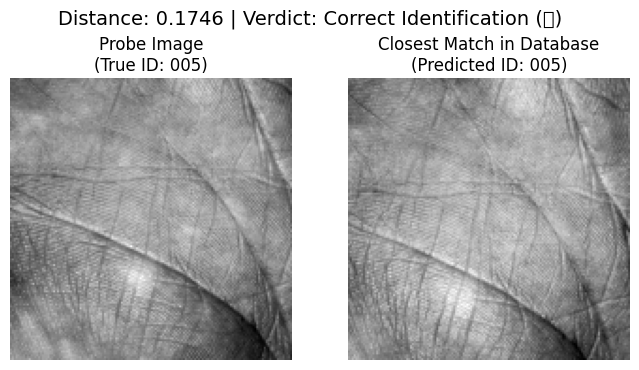


--- Test 10/10 ---
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


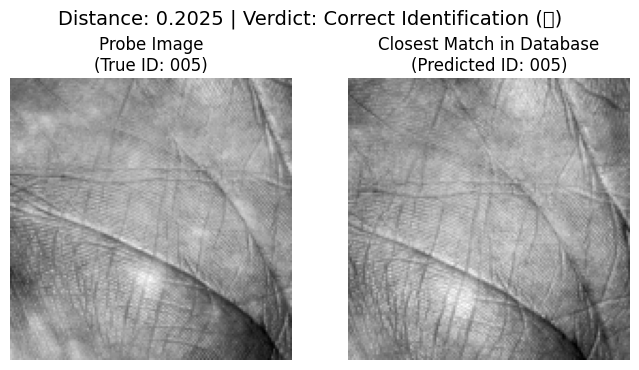


--- FINAL PERFORMANCE REPORT ---
              precision    recall  f1-score   support

         001       0.00      0.00      0.00         2
         002       0.00      0.00      0.00         2
         003       1.00      1.00      1.00         2
         004       1.00      1.00      1.00         2
         005       1.00      1.00      1.00         2

   micro avg       1.00      0.60      0.75        10
   macro avg       0.60      0.60      0.60        10
weighted avg       0.60      0.60      0.60        10



/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [61]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import classification_report

# This block assumes the 'base_network', 'X_train', 'y_train',
# 'X_test', and 'y_test' variables are available from the previous steps.

def visualize_test_case(probe_img, match_img, true_lbl, pred_lbl, distance, result_text):
    """A helper function to visualize a single test case."""
    fig, axes = plt.subplots(1, 2, figsize=(8, 4))
    axes[0].imshow(probe_img.squeeze(), cmap='gray')
    axes[0].set_title(f'Probe Image\n(True ID: {true_lbl})')
    axes[0].axis('off')
    axes[1].imshow(match_img.squeeze(), cmap='gray')
    axes[1].set_title(f'Closest Match in Database\n(Predicted ID: {pred_lbl})')
    axes[1].axis('off')
    plt.suptitle(f"Distance: {distance:.4f} | Verdict: {result_text}", fontsize=14, y=1.02)
    plt.show()

# --- Step 1: Create the Database (Gallery) of Known Users ---
print("--- Creating a reference gallery of known users... ---")
gallery_labels = np.unique(y_train)
gallery_images = []
for label in gallery_labels:
    idx = np.where(y_train == label)[0][0]
    gallery_images.append(X_train[idx])
gallery_images = np.array(gallery_images)

gallery_vectors = base_network.predict(gallery_images)
print(f"Gallery created with {len(gallery_vectors)} authorized personnel.")

# --- Step 2: Loop Through All Test Cases ---
print("\n--- Running Evaluation on the Entire Test Set ---")
recognition_threshold = 0.5

# --- NEW: Lists to store results for the final report ---
all_true_labels = []
all_predicted_labels = []

for i in range(len(X_test)):
    probe_image = X_test[i]
    true_label = y_test[i]

    print(f"\n" + "="*40)
    print(f"--- Test {i+1}/{len(X_test)} ---")

    probe_vector = base_network.predict(np.expand_dims(probe_image, axis=0))
    distances = np.linalg.norm(gallery_vectors - probe_vector, axis=1)
    min_distance_index = np.argmin(distances)
    min_distance = distances[min_distance_index]
    predicted_label = gallery_labels[min_distance_index]
    best_match_image = gallery_images[min_distance_index]

    # Determine the result
    final_prediction = "Unknown"
    result_text = "Rejected as Unknown (⚠️)"
    if min_distance <= recognition_threshold:
        final_prediction = predicted_label
        if predicted_label == true_label:
            result_text = "Correct Identification (✅)"
        else:
            result_text = "Incorrect Identification (❌)"

    # --- NEW: Store the labels for the report ---
    all_true_labels.append(true_label)
    all_predicted_labels.append(final_prediction)

    visualize_test_case(probe_image, best_match_image, true_label, predicted_label, min_distance, result_text)

# --- Step 3: Final Report with Precision, Recall, and F1 Score ---
print("\n" + "="*60)
print("--- FINAL PERFORMANCE REPORT ---")
print("="*60)

# Generate and print the classification report
# This provides precision, recall, and f1-score for each person (class).
report = classification_report(all_true_labels, all_predicted_labels, labels=gallery_labels)
print(report)

# Training Model dengan Semua Data
Setelah mengkonfirmasi bahwa model dapat memprediksi dengan jumlah sampel sedikit, kita akan melakukan scaling, memetakan model untuk jumlah sampel secara keseluruhan

In [45]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import math
import os
import glob
from tqdm import tqdm
from google.colab import drive

# --- Mount Google Drive ---
# This is a necessary first step to access your files.
drive.mount('/content/drive')

# --- Define Paths and Initialize Lists ---
smpd_path = "/content/drive/MyDrive/datasets/smpd/Sapienza University Mobile Palmprint Database(SMPD)/"
bmpd_path = "/content/drive/MyDrive/datasets/bmpd/Birjand University Mobile Palmprint Database (BMPD)/"


all_rois = []
all_labels = []

# --- 1. Process the SMPD Dataset ---
print("Processing SMPD Dataset...")
# Dynamically get all person directories, assuming they are named numerically
smpd_person_dirs = sorted([d for d in os.listdir(smpd_path) if os.path.isdir(os.path.join(smpd_path, d))])

for person_id in tqdm(smpd_person_dirs, desc="SMPD Progress"):
    person_dir = os.path.join(smpd_path, person_id)

    # Get all image files for the person
    image_files = sorted(glob.glob(os.path.join(person_dir, "*.JPG")))

    for file_path in image_files:
        filename = os.path.basename(file_path)
        # Apply the filter: only include files with '_F_' or '_RF_'
        if '_F_' in filename or '_RF_' in filename:
            roi = process_palm_image(file_path, final_size=(150, 150))
            if roi is not None:
                all_rois.append(roi)
                # Add a prefix to the label to make it unique
                all_labels.append(f"smpd_{person_id}")

# --- 2. Process the BMPD Dataset ---
print("\nProcessing BMPD Dataset...")
# Dynamically get all person directories
bmpd_person_dirs = sorted([d for d in os.listdir(bmpd_path) if os.path.isdir(os.path.join(bmpd_path, d))])

for person_id in tqdm(bmpd_person_dirs, desc="BMPD Progress"):
    person_dir = os.path.join(bmpd_path, person_id)

    # Get all image files for the person (no filtering needed for BMPD)
    image_files = sorted(glob.glob(os.path.join(person_dir, "*.JPG")))

    for file_path in image_files:
        roi = process_palm_image(file_path, final_size=(150, 150))
        if roi is not None:
            all_rois.append(roi)
            # Add a prefix to the label to make it unique
            all_labels.append(f"bmpd_{person_id}")


# --- 3. Final Conversion and Summary ---
# Optimization: Converting a list to a NumPy array once at the end is efficient.
all_rois = np.array(all_rois)
all_labels = np.array(all_labels)

# Get the number of unique people by counting unique labels
num_unique_people = len(np.unique(all_labels))

print(f"\nSuccessfully processed a total of {len(all_rois)} images.")
print(f"Found {num_unique_people} unique individuals across both datasets.")
print(f"Shape of the ROIs array: {all_rois.shape}")
print(f"Shape of the labels array: {all_labels.shape}")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Processing SMPD Dataset...


SMPD Progress: 100%|██████████| 92/92 [03:40<00:00,  2.40s/it]



Processing BMPD Dataset...


BMPD Progress: 100%|██████████| 41/41 [02:05<00:00,  3.07s/it]


Successfully processed a total of 3419 images.
Found 133 unique individuals across both datasets.
Shape of the ROIs array: (3419, 150, 150)
Shape of the labels array: (3419,)


In [46]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import numpy as np
from collections import Counter

# --- 1. Label Encoding ---
# This part is the same.
label_encoder = LabelEncoder()
all_labels_encoded = label_encoder.fit_transform(all_labels)

# --- 2. NEW: Data Cleaning Step ---
# We count how many images each person has.
label_counts = Counter(all_labels_encoded)

# We identify which people have more than one image.
labels_to_keep = [label for label, count in label_counts.items() if count > 1]
print(f"Found {len(label_counts)} total subjects.")
print(f"Found {len(labels_to_keep)} subjects with more than 1 image. Removing single-image subjects...")

# We create a "mask" to select only the data from the people we want to keep.
mask = np.isin(all_labels_encoded, labels_to_keep)
X_filtered = all_rois[mask]
y_filtered = all_labels_encoded[mask]

print(f"Original number of images: {len(all_rois)}")
print(f"Number of images after filtering: {len(X_filtered)}")

# --- 3. Stratified Train-Test Split (on Filtered Data) ---
# Now, we perform the split on the CLEANED data.
n_samples = X_filtered.shape[0]
X_flat = X_filtered.reshape((n_samples, -1))

X_train_flat, X_test_flat, y_train, y_test = train_test_split(
    X_flat,
    y_filtered,
    test_size=0.2,
    random_state=42,
    stratify=y_filtered # Stratify on the filtered labels
)

# --- 4. Reshape Images Back to 2D and Preprocess ---
# This part is the same.
X_train = X_train_flat.reshape((-1, 150, 150))
X_test = X_test_flat.reshape((-1, 150, 150))

X_train = X_train.astype('float32') / 255.0
X_test = X_test.astype('float32') / 255.0
X_train = np.expand_dims(X_train, axis=-1)
X_test = np.expand_dims(X_test, axis=-1)

print(f"\nTotal unique classes for training/testing: {len(np.unique(y_filtered))}")
print(f"Training set shape: {X_train.shape}")
print(f"Testing set shape: {X_test.shape}")
print(f"Training labels shape: {y_train.shape}")
print(f"Testing labels shape: {y_test.shape}")

Found 133 total subjects.
Found 133 subjects with more than 1 image. Removing single-image subjects...
Original number of images: 3419
Number of images after filtering: 3419

Total unique classes for training/testing: 133
Training set shape: (2735, 150, 150, 1)
Testing set shape: (684, 150, 150, 1)
Training labels shape: (2735,)
Testing labels shape: (684,)


--- Preparing all training pairs in memory. This may take a moment... ---
Created 2735 pairs. Shape: (2735, 2, 150, 150, 1)
--- Pairs shuffled. ---


Model: "functional_12"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_16      │ (None, 150, 150,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ input_layer_17      │ (None, 150, 150,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ functional_11       │ (None, 256)       │ 44,934,144 │ input_layer_16[0… │
│ (Functional)        │                   │            │ input_layer_17[0… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lambda_4 (Lambda)   │ (None, 1)         │          0 │ functional_11[0]… │
│                     │                   │            │ functional_11[1]… │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 44,934,144 (171.41 MB)

 Trainable params: 44,934,144 (171.41 MB)

 Non-trainable params: 0 (0.00 B)


--- Starting Model Training ---
Epoch 1/15
77/77 ━━━━━━━━━━━━━━━━━━━━ 12s 127ms/step - loss: 0.2623 - val_loss: 0.2148
Epoch 2/15
77/77 ━━━━━━━━━━━━━━━━━━━━ 17s 89ms/step - loss: 0.1925 - val_loss: 0.1933
Epoch 3/15
77/77 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step - loss: 0.1603 - val_loss: 0.1648
Epoch 4/15
77/77 ━━━━━━━━━━━━━━━━━━━━ 7s 90ms/step - loss: 0.1284 - val_loss: 0.1547
Epoch 5/15
77/77 ━━━━━━━━━━━━━━━━━━━━ 7s 93ms/step - loss: 0.1149 - val_loss: 0.1422
Epoch 6/15
77/77 ━━━━━━━━━━━━━━━━━━━━ 10s 93ms/step - loss: 0.0956 - val_loss: 0.1391
Epoch 7/15
77/77 ━━━━━━━━━━━━━━━━━━━━ 7s 90ms/step - loss: 0.0847 - val_loss: 0.1382
Epoch 8/15
77/77 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step - loss: 0.0793 - val_loss: 0.1418
Epoch 9/15
77/77 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step - loss: 0.0709 - val_loss: 0.1360
Epoch 10/15
77/77 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - loss: 0.0654 - val_loss: 0.1367
Epoch 11/15
77/77 ━━━━━━━━━━━━━━━━━━━━ 7s 94ms/step - loss: 0.0589 - val_loss: 0.1370
Epoch 12/15
77/77 ━━━━━

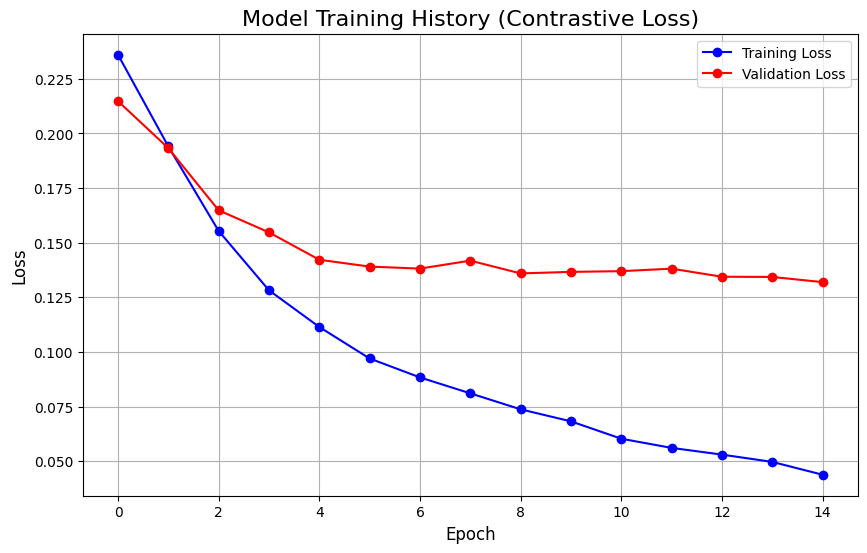

In [52]:
import random
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Flatten, Dense, Lambda
from tensorflow.keras.optimizers import Adam
import tensorflow.keras.backend as K
import matplotlib.pyplot as plt
import numpy as np

# --- 1. Model Architecture ---
def create_base_network(input_shape):
    input_layer = Input(shape=input_shape)
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(input_layer)
    x = MaxPooling2D()(x)
    x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
    x = MaxPooling2D()(x)
    x = Flatten()(x)
    x = Dense(256, activation='relu')(x)
    return Model(input_layer, x)

# --- Helper functions (Loss and Distance) ---
def euclidean_distance(vects):
    x, y = vects
    sum_square = K.sum(K.square(x - y), axis=1, keepdims=True)
    return K.sqrt(K.maximum(sum_square, K.epsilon()))

def contrastive_loss(y_true, y_pred):
    margin = 1.0
    y_true = tf.cast(y_true, y_pred.dtype)
    square_pred = K.square(y_pred)
    margin_square = K.square(K.maximum(margin - y_pred, 0))
    return K.mean(y_true * square_pred + (1 - y_true) * margin_square)

# --- 2. Original Data Preparation: Create All Pairs in Memory ---
# This function creates one pair for each image in your training set.
def create_pairs(x, y):
    pairs, pair_labels = [], []
    # Create a dictionary mapping each label to its indices
    label_to_indices = {label: np.where(y == label)[0] for label in np.unique(y)}

    for i in range(len(x)):
        current_image, current_label = x[i], y[i]

        # 50% chance for a positive pair
        if random.random() > 0.5:
            # Find an image of the same person
            idx2 = random.choice([j for j in label_to_indices[current_label] if j != i])
            other_image = x[idx2]
            pairs.append([current_image, other_image])
            pair_labels.append(1.0)
        # 50% chance for a negative pair
        else:
            # Find an image of a different person
            other_label = random.choice([l for l in label_to_indices if l != current_label])
            idx2 = random.choice(label_to_indices[other_label])
            other_image = x[idx2]
            pairs.append([current_image, other_image])
            pair_labels.append(0.0)

    return np.array(pairs), np.array(pair_labels)

print("--- Preparing all training pairs in memory. This may take a moment... ---")
# This creates 2761 pairs based on your X_train size
train_pairs, train_labels = create_pairs(X_train, y_train)
print(f"Created {len(train_pairs)} pairs. Shape: {train_pairs.shape}")

# Important: Shuffle the pairs before splitting for validation
p = np.random.permutation(len(train_pairs))
train_pairs = train_pairs[p]
train_labels = train_labels[p]
print("--- Pairs shuffled. ---")

# --- 3. Build and Compile the Model ---
image_shape = X_train.shape[1:]
base_network = create_base_network(image_shape)

input_a = Input(shape=image_shape)
input_b = Input(shape=image_shape)

processed_a = base_network(input_a)
processed_b = base_network(input_b)

distance = Lambda(euclidean_distance)([processed_a, processed_b])
siamese_model = Model([input_a, input_b], distance)
siamese_model.compile(loss=contrastive_loss, optimizer=Adam(learning_rate=0.0001))
siamese_model.summary()

# --- 4. Train the Model using the Pre-generated Array ---
print("\n--- Starting Model Training ---")
history = siamese_model.fit(
    [train_pairs[:, 0], train_pairs[:, 1]],
    train_labels,
    epochs=15,
    batch_size=32, # Using 32 is a bit faster than 8
    validation_split=0.1 # Using your original validation method
)
print("--- Model Training Complete ---")

# --- 5. Visualize Training History ---
print("\n--- Generating Training History Plot ---")
plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], 'bo-', label='Training Loss')
plt.plot(history.history['val_loss'], 'ro-', label='Validation Loss')
plt.title('Model Training History (Contrastive Loss)', fontsize=16)
plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.legend()
plt.grid(True)
plt.show()

--- Creating a reference gallery of known users (single image method)... ---
Gallery created with 133 authorized personnel.

--- Running one-by-one evaluation on the test set ---
--- All test cases processed ---

--- VISUALIZING A SAMPLE OF RESULTS ---

--- Correct Identification Examples (✅) ---


/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


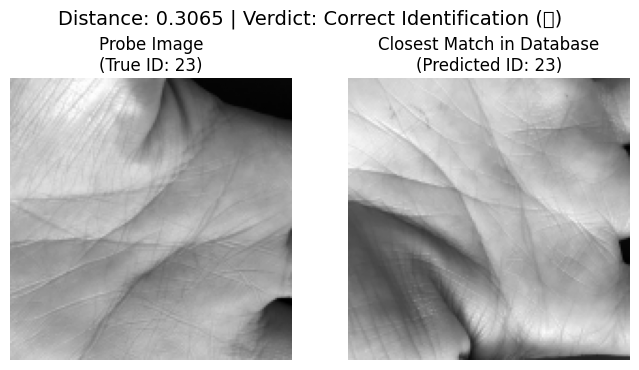

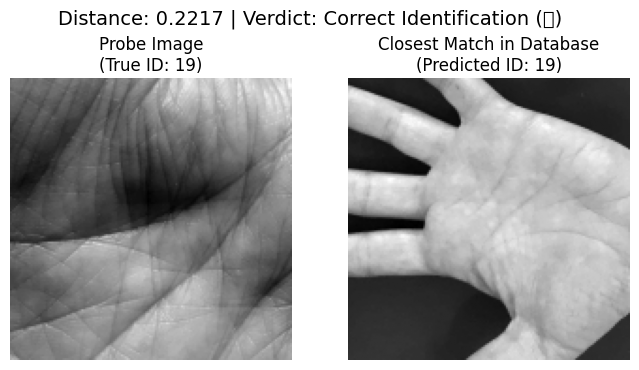

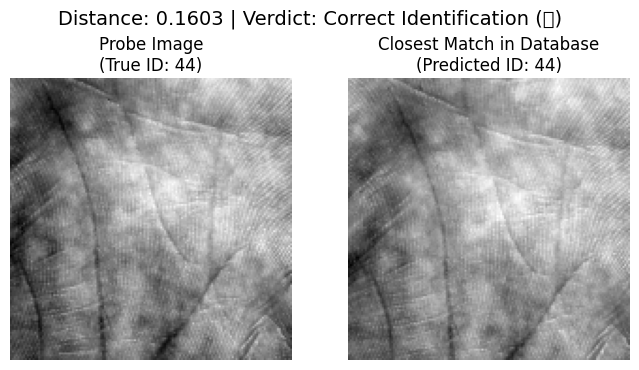


--- Incorrect Identification (Mismatch) Examples (❌) ---


/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


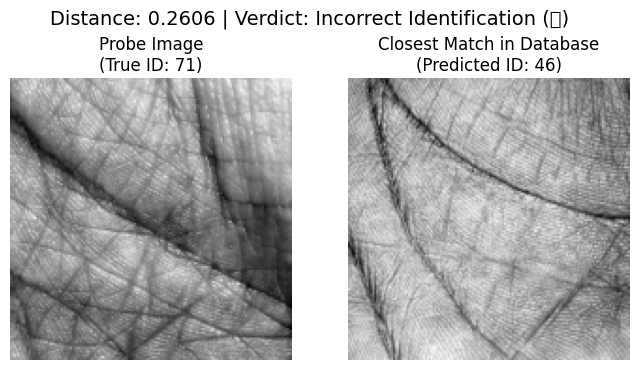

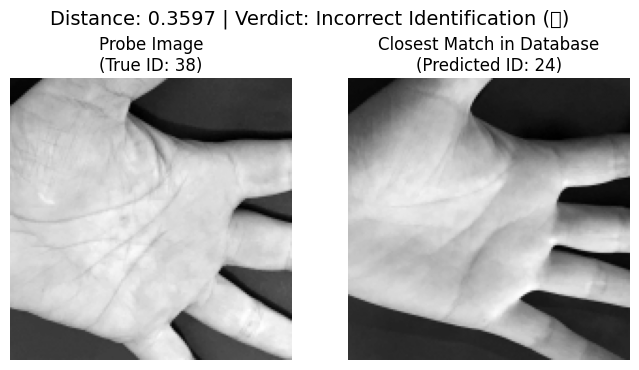

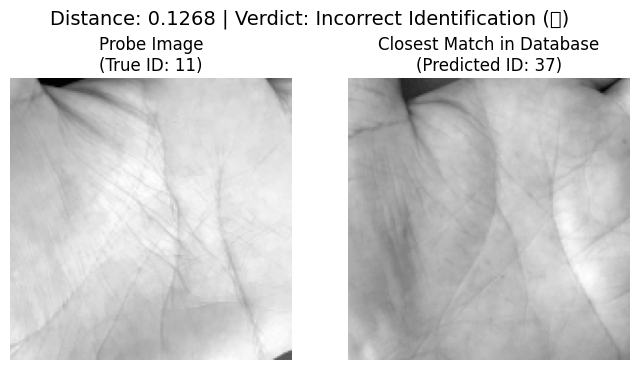


--- Rejected as Unknown (Indeterminate) Examples (⚠️) ---
No rejected examples found to display.

--- FINAL PERFORMANCE REPORT ---
              precision    recall  f1-score   support

           0       0.12      0.25      0.16         8
           1       0.50      0.88      0.64         8
           2       0.50      0.12      0.20         8
           3       0.00      0.00      0.00         8
           4       0.50      0.25      0.33         8
           5       0.50      0.20      0.29         5
           6       1.00      1.00      1.00         8
           7       0.29      0.29      0.29         7
           8       0.14      0.12      0.13         8
           9       0.44      0.88      0.58         8
          10       0.40      0.50      0.44         8
          11       0.00      0.00      0.00         8
          12       0.43      0.38      0.40         8
          13       0.17      0.12      0.14         8
          14       0.31      0.50      0.38         8
   

In [53]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import classification_report

# This block assumes the 'base_network', 'X_train', 'y_train',
# 'X_test', 'y_test', and 'label_encoder' variables are available.

# (The visualize_test_case function is assumed to be defined)

# --- Step 1: Create the Gallery ---
print("--- Creating a reference gallery of known users (single image method)... ---")
unique_train_labels = np.unique(y_train)
gallery_images = []
gallery_labels = []
for label in unique_train_labels:
    idx = np.where(y_train == label)[0][0]
    gallery_images.append(X_train[idx])
    gallery_labels.append(label)

gallery_images = np.array(gallery_images)
gallery_vectors = base_network.predict(gallery_images, verbose=0)
print(f"Gallery created with {len(gallery_vectors)} authorized personnel.")


# --- Step 2: Process All Test Cases & Collect Examples ---
print("\n--- Running one-by-one evaluation on the test set ---")
recognition_threshold = 0.8 # NOTE: You might need to adjust this value!
all_true_labels = []
all_predicted_labels = []
unknown_label = -1

# Lists to store our examples
correct_examples = []
incorrect_examples = []
rejected_examples = []

for i in range(len(X_test)):
    probe_image = X_test[i]
    true_label = y_test[i]

    probe_vector = base_network.predict(np.expand_dims(probe_image, axis=0), verbose=0)

    distances = np.linalg.norm(gallery_vectors - probe_vector, axis=1)
    min_distance_index = np.argmin(distances)
    min_distance = distances[min_distance_index]
    predicted_label_id = gallery_labels[min_distance_index]

    # Determine the result and store examples
    if min_distance <= recognition_threshold:
        final_prediction = predicted_label_id
        if predicted_label_id == true_label:
            result_text = "Correct Identification (✅)"
            if len(correct_examples) < 3:
                correct_examples.append((probe_image, gallery_images[min_distance_index], true_label, predicted_label_id, min_distance, result_text))
        else:
            result_text = "Incorrect Identification (❌)"
            if len(incorrect_examples) < 3:
                incorrect_examples.append((probe_image, gallery_images[min_distance_index], true_label, predicted_label_id, min_distance, result_text))
    else:
        final_prediction = unknown_label
        result_text = "Rejected as Unknown (⚠️)"
        if len(rejected_examples) < 3:
            rejected_examples.append((probe_image, gallery_images[min_distance_index], true_label, predicted_label_id, min_distance, result_text))

    all_true_labels.append(true_label)
    all_predicted_labels.append(final_prediction)

print("--- All test cases processed ---")


# --- Step 3: Selective Visualization ---
print("\n" + "="*60)
print("--- VISUALIZING A SAMPLE OF RESULTS ---")
print("="*60)

# 1. Show CORRECT examples
print("\n--- Correct Identification Examples (✅) ---")
if not correct_examples: print("No correct examples found to display.")
for probe_img, match_img, true_lbl, pred_lbl, dist, res_txt in correct_examples:
    visualize_test_case(probe_img, match_img, true_lbl, pred_lbl, dist, res_txt)

# 2. Show INCORRECT examples
print("\n--- Incorrect Identification (Mismatch) Examples (❌) ---")
if not incorrect_examples: print("No incorrect examples found to display.")
for probe_img, match_img, true_lbl, pred_lbl, dist, res_txt in incorrect_examples:
    visualize_test_case(probe_img, match_img, true_lbl, pred_lbl, dist, res_txt)

# 3. Show REJECTED examples
print("\n--- Rejected as Unknown (Indeterminate) Examples (⚠️) ---")
if not rejected_examples: print("No rejected examples found to display.")
for probe_img, match_img, true_lbl, pred_lbl, dist, res_txt in rejected_examples:
    visualize_test_case(probe_img, match_img, true_lbl, "Unknown", dist, res_txt)


# --- Step 4: Final Performance Report ---
print("\n" + "="*60)
print("--- FINAL PERFORMANCE REPORT ---")
print("="*60)

report = classification_report(all_true_labels, all_predicted_labels, labels=np.append(gallery_labels, unknown_label), zero_division=0)
print(report)

Model: "functional_15"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_anchor        │ (None, 150, 150,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ input_pair          │ (None, 150, 150,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ base_network_v2     │ (None, 256)       │ 90,113,216 │ input_anchor[0][… │
│ (Functional)        │                   │            │ input_pair[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lambda_7 (Lambda)   │ (None, 1)         │          0 │ base_network_v2[… │
│                     │                   │            │ base_network_v2[… │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 90,113,216 (343.75 MB)

 Trainable params: 90,111,424 (343.75 MB)

 Non-trainable params: 1,792 (7.00 KB)


--- Starting Upgraded Model Training for 30 epochs ---
Epoch 1/30
42/42 ━━━━━━━━━━━━━━━━━━━━ 38s 603ms/step - loss: 0.9471 - val_loss: 0.4924
Epoch 2/30
42/42 ━━━━━━━━━━━━━━━━━━━━ 25s 595ms/step - loss: 1.0271 - val_loss: 0.4928
Epoch 3/30
42/42 ━━━━━━━━━━━━━━━━━━━━ 23s 559ms/step - loss: 0.9807 - val_loss: 0.4268
Epoch 4/30
42/42 ━━━━━━━━━━━━━━━━━━━━ 24s 564ms/step - loss: 0.8785 - val_loss: 0.4436
Epoch 5/30
42/42 ━━━━━━━━━━━━━━━━━━━━ 24s 565ms/step - loss: 0.7283 - val_loss: 0.3831
Epoch 6/30
42/42 ━━━━━━━━━━━━━━━━━━━━ 24s 579ms/step - loss: 0.6574 - val_loss: 0.3486
Epoch 7/30
42/42 ━━━━━━━━━━━━━━━━━━━━ 24s 581ms/step - loss: 0.5817 - val_loss: 0.5477
Epoch 8/30
42/42 ━━━━━━━━━━━━━━━━━━━━ 41s 590ms/step - loss: 0.5802 - val_loss: 0.5484
Epoch 9/30
42/42 ━━━━━━━━━━━━━━━━━━━━ 25s 587ms/step - loss: 0.5573 - val_loss: 0.6343
Epoch 10/30
42/42 ━━━━━━━━━━━━━━━━━━━━ 25s 605ms/step - loss: 0.4965 - val_loss: 0.4979
Epoch 11/30
42/42 ━━━━━━━━━━━━━━━━━━━━ 40s 581ms/step - loss: 0.4425 - va

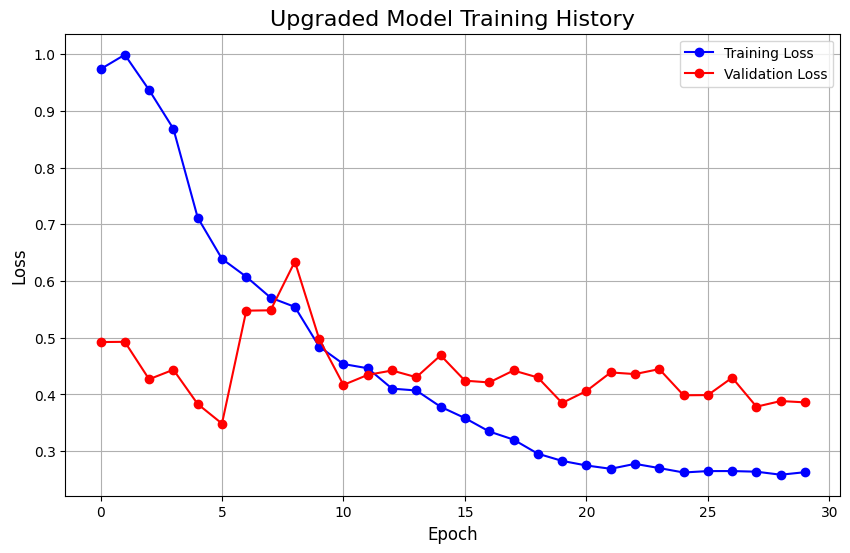

In [55]:
import random
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Flatten, Dense, Lambda, BatchNormalization, Dropout
from tensorflow.keras.layers import RandomFlip, RandomRotation
from tensorflow.keras.optimizers import Adam
import tensorflow.keras.backend as K
from tensorflow.keras.utils import Sequence
import matplotlib.pyplot as plt
import numpy as np

# --- 1. Data Augmentation Pipeline ---
# We define a small set of random transformations to apply to our images.
data_augmentation = tf.keras.Sequential([
    RandomFlip("horizontal"),
    RandomRotation(0.05), # Rotate by a small amount
])

# --- 2. Data Generator with Built-in Augmentation ---
class SiameseDataGenerator(Sequence):
    # Added **kwargs and super().__init__ to prevent the UserWarning
    def __init__(self, x_set, y_set, batch_size, **kwargs):
        super().__init__(**kwargs)
        self.x, self.y = x_set, y_set
        self.batch_size = batch_size
        self.indices = {label: np.where(self.y == label)[0] for label in np.unique(self.y)}
        self.on_epoch_end()

    def __len__(self):
        return len(self.x) // self.batch_size

    def __getitem__(self, idx):
        pairs = []
        labels = []
        current_batch_indices = np.arange(idx * self.batch_size, (idx + 1) * self.batch_size)

        for i in current_batch_indices:
            current_image = self.x[i]
            current_label = self.y[i]

            if random.random() > 0.5: # Positive pair
                positive_idx = random.choice([j for j in self.indices[current_label] if j != i])
                positive_image = self.x[positive_idx]
                pairs.append([current_image, positive_image])
                labels.append(1.0)
            else: # Negative pair
                negative_label = random.choice([l for l in self.indices.keys() if l != current_label])
                negative_idx = random.choice(self.indices[negative_label])
                negative_image = self.x[negative_idx]
                pairs.append([current_image, negative_image])
                labels.append(0.0)

        pairs = np.array(pairs)

        # Apply data augmentation to both images in each pair
        augmented_a = data_augmentation(pairs[:, 0])
        augmented_b = data_augmentation(pairs[:, 1])

        return (augmented_a, augmented_b), np.array(labels)

    def on_epoch_end(self):
        p = np.random.permutation(len(self.x))
        self.x, self.y = self.x[p], self.y[p]

# --- 3. A More Powerful V2 Model Architecture ---
def create_base_network_v2(input_shape):
    input_layer = Input(shape=input_shape)

    # Block 1
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(input_layer)
    x = BatchNormalization()(x) # For stability
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPooling2D(pool_size=(2, 2))(x)
    x = Dropout(0.25)(x) # For regularization

    # Block 2
    x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPooling2D(pool_size=(2, 2))(x)
    x = Dropout(0.25)(x)

    # Final embedding layers
    x = Flatten()(x)
    x = Dense(512, activation='relu')(x)
    x = BatchNormalization()(x)
    x = Dropout(0.5)(x)
    x = Dense(256)(x) # The final 256-dimensional embedding vector

    x = Lambda(lambda v: K.l2_normalize(v, axis=1))(x)

    return Model(input_layer, x, name="base_network_v2")

# --- Helper functions (Unchanged) ---
def euclidean_distance(vects):
    x, y = vects
    sum_square = K.sum(K.square(x - y), axis=1, keepdims=True)
    return K.sqrt(K.maximum(sum_square, K.epsilon()))

def contrastive_loss(y_true, y_pred):
    margin = 1.0
    y_true = tf.cast(y_true, y_pred.dtype)
    square_pred = K.square(y_pred)
    margin_square = K.square(K.maximum(margin - y_pred, 0))
    return K.mean(y_true * square_pred + (1 - y_true) * margin_square)

# --- 4. Build and Compile the Model ---
image_shape = X_train.shape[1:]
base_network = create_base_network_v2(image_shape)

input_a = Input(shape=image_shape, name='input_anchor')
input_b = Input(shape=image_shape, name='input_pair')
processed_a = base_network(input_a)
processed_b = base_network(input_b)
distance = Lambda(euclidean_distance)([processed_a, processed_b])
siamese_model = Model([input_a, input_b], distance)
siamese_model.compile(loss=contrastive_loss, optimizer=Adam(learning_rate=0.0001))
siamese_model.summary()

# --- 5. Train the Upgraded Model ---
BATCH_SIZE = 64
EPOCHS = 30 # Train for longer since we have augmentation

train_generator = SiameseDataGenerator(X_train, y_train, BATCH_SIZE)
validation_generator = SiameseDataGenerator(X_test, y_test, BATCH_SIZE)

print(f"\n--- Starting Upgraded Model Training for {EPOCHS} epochs ---")
history = siamese_model.fit(
    train_generator,
    epochs=EPOCHS,
    validation_data=validation_generator,
    verbose=1
)
print("--- Model Training Complete ---")

# --- 6. Visualize Training History ---
# Completed the plotting code
print("\n--- Generating Training History Plot ---")
plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], 'bo-', label='Training Loss')
plt.plot(history.history['val_loss'], 'ro-', label='Validation Loss')
plt.title('Upgraded Model Training History', fontsize=16)
plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.legend()
plt.grid(True)
plt.show()

--- Creating a reference gallery of known users (single image method)... ---
Gallery created with 133 authorized personnel.

--- Running one-by-one evaluation on the test set ---
--- All test cases processed ---

--- VISUALIZING A SAMPLE OF RESULTS ---

--- Correct Identification Examples (✅) ---


/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


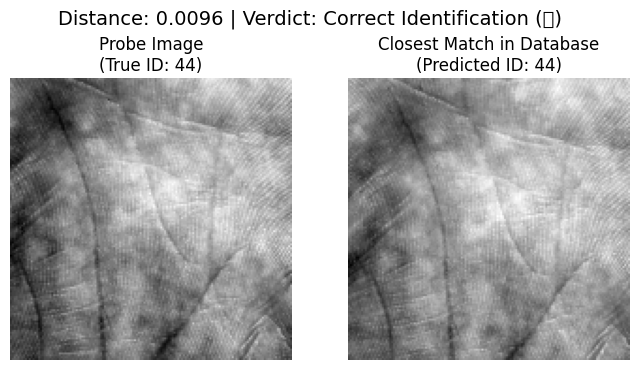

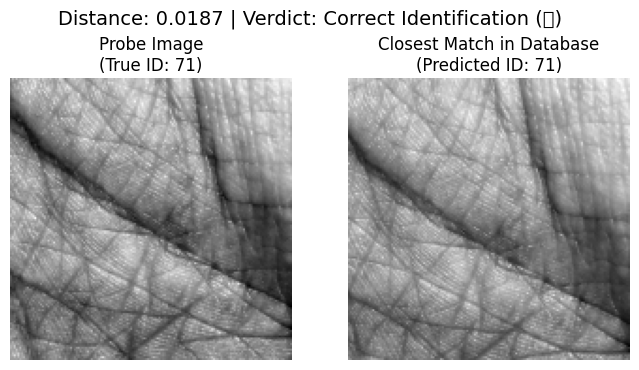

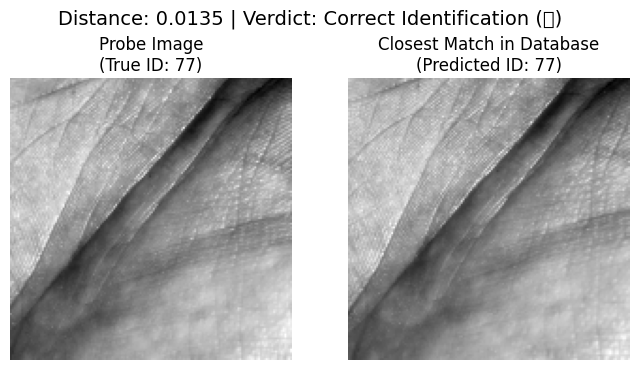


--- Incorrect Identification (Mismatch) Examples (❌) ---


/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


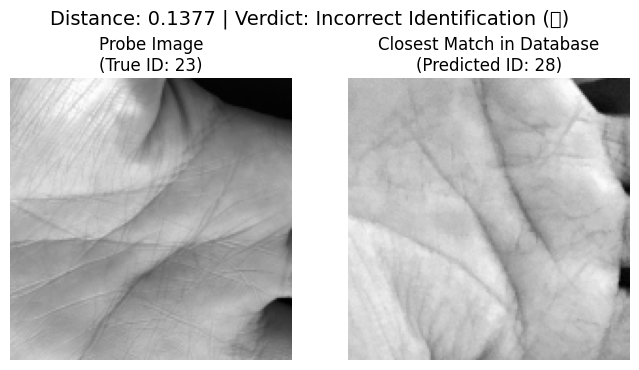

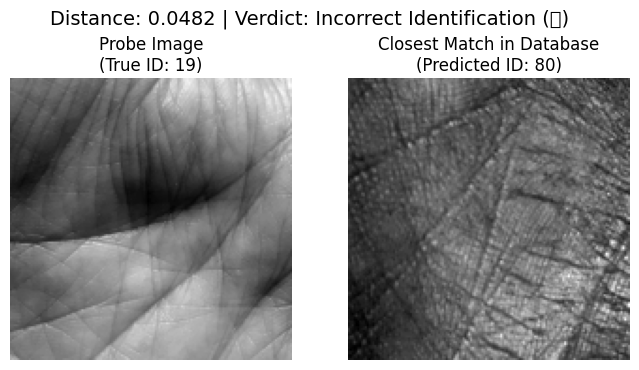

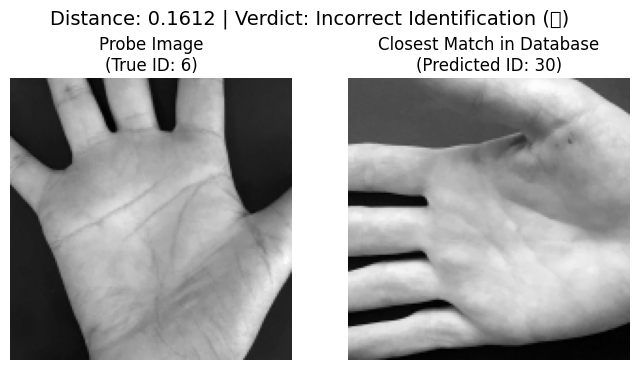


--- Rejected as Unknown (Indeterminate) Examples (⚠️) ---


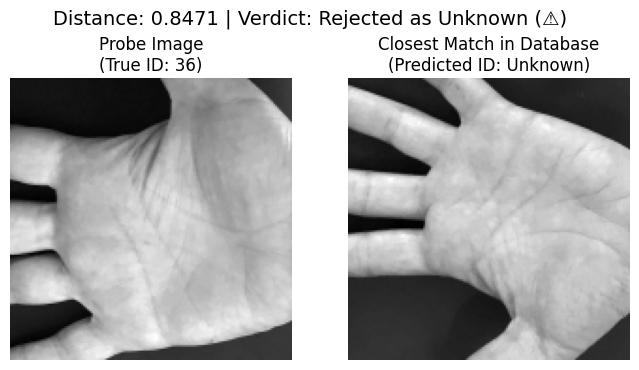

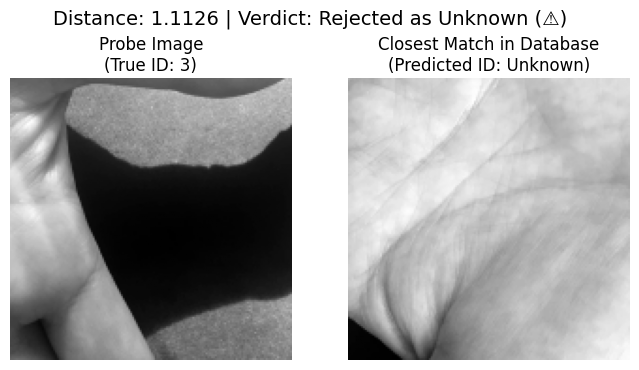

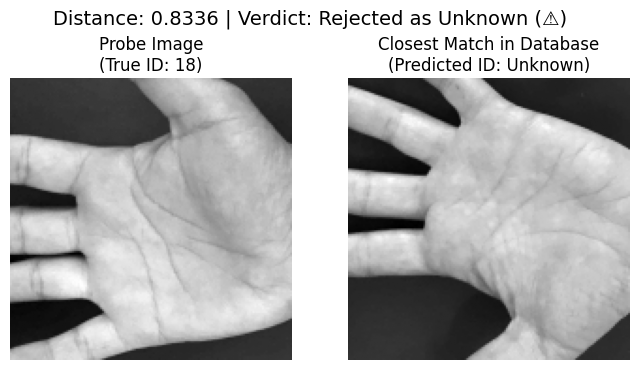


--- FINAL PERFORMANCE REPORT ---
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         8
           1       0.75      0.38      0.50         8
           2       1.00      0.38      0.55         8
           3       0.07      0.25      0.11         8
           4       1.00      0.12      0.22         8
           5       0.00      0.00      0.00         5
           6       0.50      0.25      0.33         8
           7       0.06      0.14      0.09         7
           8       0.00      0.00      0.00         8
           9       0.80      0.50      0.62         8
          10       0.60      0.38      0.46         8
          11       0.57      0.50      0.53         8
          12       1.00      0.12      0.22         8
          13       0.00      0.00      0.00         8
          14       1.00      0.25      0.40         8
          15       0.44      0.50      0.47         8
          16       0.70      0.88      0.78    

In [56]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import classification_report

# This block assumes the 'base_network', 'X_train', 'y_train',
# 'X_test', 'y_test', and 'label_encoder' variables are available.

# (The visualize_test_case function is assumed to be defined)

# --- Step 1: Create the Gallery ---
print("--- Creating a reference gallery of known users (single image method)... ---")
unique_train_labels = np.unique(y_train)
gallery_images = []
gallery_labels = []
for label in unique_train_labels:
    idx = np.where(y_train == label)[0][0]
    gallery_images.append(X_train[idx])
    gallery_labels.append(label)

gallery_images = np.array(gallery_images)
gallery_vectors = base_network.predict(gallery_images, verbose=0)
print(f"Gallery created with {len(gallery_vectors)} authorized personnel.")


# --- Step 2: Process All Test Cases & Collect Examples ---
print("\n--- Running one-by-one evaluation on the test set ---")
recognition_threshold = 0.8 # NOTE: You might need to adjust this value!
all_true_labels = []
all_predicted_labels = []
unknown_label = -1

# Lists to store our examples
correct_examples = []
incorrect_examples = []
rejected_examples = []

for i in range(len(X_test)):
    probe_image = X_test[i]
    true_label = y_test[i]

    probe_vector = base_network.predict(np.expand_dims(probe_image, axis=0), verbose=0)

    distances = np.linalg.norm(gallery_vectors - probe_vector, axis=1)
    min_distance_index = np.argmin(distances)
    min_distance = distances[min_distance_index]
    predicted_label_id = gallery_labels[min_distance_index]

    # Determine the result and store examples
    if min_distance <= recognition_threshold:
        final_prediction = predicted_label_id
        if predicted_label_id == true_label:
            result_text = "Correct Identification (✅)"
            if len(correct_examples) < 3:
                correct_examples.append((probe_image, gallery_images[min_distance_index], true_label, predicted_label_id, min_distance, result_text))
        else:
            result_text = "Incorrect Identification (❌)"
            if len(incorrect_examples) < 3:
                incorrect_examples.append((probe_image, gallery_images[min_distance_index], true_label, predicted_label_id, min_distance, result_text))
    else:
        final_prediction = unknown_label
        result_text = "Rejected as Unknown (⚠️)"
        if len(rejected_examples) < 3:
            rejected_examples.append((probe_image, gallery_images[min_distance_index], true_label, predicted_label_id, min_distance, result_text))

    all_true_labels.append(true_label)
    all_predicted_labels.append(final_prediction)

print("--- All test cases processed ---")


# --- Step 3: Selective Visualization ---
print("\n" + "="*60)
print("--- VISUALIZING A SAMPLE OF RESULTS ---")
print("="*60)

# 1. Show CORRECT examples
print("\n--- Correct Identification Examples (✅) ---")
if not correct_examples: print("No correct examples found to display.")
for probe_img, match_img, true_lbl, pred_lbl, dist, res_txt in correct_examples:
    visualize_test_case(probe_img, match_img, true_lbl, pred_lbl, dist, res_txt)

# 2. Show INCORRECT examples
print("\n--- Incorrect Identification (Mismatch) Examples (❌) ---")
if not incorrect_examples: print("No incorrect examples found to display.")
for probe_img, match_img, true_lbl, pred_lbl, dist, res_txt in incorrect_examples:
    visualize_test_case(probe_img, match_img, true_lbl, pred_lbl, dist, res_txt)

# 3. Show REJECTED examples
print("\n--- Rejected as Unknown (Indeterminate) Examples (⚠️) ---")
if not rejected_examples: print("No rejected examples found to display.")
for probe_img, match_img, true_lbl, pred_lbl, dist, res_txt in rejected_examples:
    visualize_test_case(probe_img, match_img, true_lbl, "Unknown", dist, res_txt)


# --- Step 4: Final Performance Report ---
print("\n" + "="*60)
print("--- FINAL PERFORMANCE REPORT ---")
print("="*60)

report = classification_report(all_true_labels, all_predicted_labels, labels=np.append(gallery_labels, unknown_label), zero_division=0)
print(report)